In [8]:
from __future__ import print_function,division
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import matplotlib.image as mpimg
import glob

get_ipython().run_line_magic('matplotlib','inline')
plt.rcParams['figure.figsize'] = (10.0,8.0)
plt.rcParams['image.interpolation'] = 'nearest'
#plt.rcParams['image.cmap'] = 'gray'

In [9]:
def disp_images(images,type="color"):
    image_type = len(images.shape)
    images = np.reshape(images,[images.shape[0],-1])
    sqrtn = int(np.ceil(np.sqrt(images.shape[0])))
    if type=="color":   
        global sqrtimg
        sqrtimg = int(np.ceil(np.sqrt(images.shape[1]/3))) #--------------------------------------------------------        
    else:  
        print("error, need to revise")
    figure = plt.figure(figsize = (sqrtn,sqrtn))
    gs = gridspec.GridSpec(sqrtn,sqrtn)
    gs.update(wspace = 0.05,hspace = 0.05)
    for i,img in enumerate(images):
        ax = plt.subplot(gs[i])
        plt.axis('off')
        ax.set_xticklabels([])
        ax.set_yticklabels([])
        ax.set_aspect('equal')
        plt.imshow(img.reshape([sqrtimg,sqrtimg,3]))

def preprocess(x):
    return 2*x-1.0
def deprocess(x):
    return (x+1.0) / 2.0
def count_params():
    param_count = np.sum([np.prod(x.get_shape().as_list()) for x in tf.global_variables()])
    return param_count
def session():
    config = tf.ConfigProto()
    config.gpu_options.allow_growth = True
    session = tf.Session(config = config)
    return session
def activation(x, alpha = 0.01):# leaky relu
    a = tf.maximum(x,alpha*x)
    return a
def sample_noise(batch_size,dim):
    random_noise = tf.random_uniform(maxval = 1,minval = -1,shape =[batch_size,dim])
    return random_noise

def get_solvers(lr = 1e-3, beta1 = 0.5):
    d_solver = tf.train.AdamOptimizer(learning_rate = lr,beta1 = beta1)
    g_solver = tf.train.AdamOptimizer(learning_rate = lr,beta1 = beta1)
    return d_solver,g_solver
def wgan_gp_loss(logits_real,logits_fake,batch_size,x,G_sample):
    d_loss = - tf.reduce_mean(logits_real) + tf.reduce_mean(logits_fake)
    g_loss = - tf.reduce_mean(logits_fake)
    lam = 10
    eps = tf.random_uniform([batch_size,1],minval=0.0,maxval=1.0)
    #a = tf.reshape(x,[batch_size,-1])    
    #b = tf.reshape(G_sample,[batch_size,-1])
    x_h = eps*x + (1-eps)*G_sample  #----------random relax search image-----------------------------------

    with tf.variable_scope("",reuse=True) as scope:# cannot understand gradient penalty
        #temp = tf.reshape(x_h,[batch_size,32,32,3])#-------------------------------------------change size
        grad_d_x_h = tf.gradients(discriminator(x_h),x_h)# [batch,32*32*3]
    grad_norm = tf.norm(grad_d_x_h[0],axis=1,ord='euclidean')#fetch x-gradient and apply euclidean calibration
    grad_pen = tf.reduce_mean(tf.square(grad_norm-1))
    
    d_loss += lam*grad_pen  #this is the key pivot at WGAN-GP
    tf.summary.scalar("d_loss",d_loss)
    tf.summary.scalar("g_loss",g_loss)
    return d_loss,g_loss


def wgan_loss(logits_real,logits_fake,batch_size,x,G_sample):  #not yet regularization
    d_loss = - tf.reduce_mean(logits_real) + tf.reduce_mean(logits_fake)
    g_loss = - tf.reduce_mean(logits_fake)
    tf.summary.scalar("d_loss",d_loss)
    tf.summary.scalar("g_loss",g_loss)
    return d_loss,g_loss

def dcgan_loss(logits_real,logits_fake,batch_size,x,G_sample): #not yet regularization
    logits_real = tf.nn.sigmoid(logits_real)
    logits_fake = tf.nn.sigmoid(logits_fake)
    d_loss = - tf.reduce_mean(tf.log(tf.clip_by_value(logits_real,1e-12,1.0)))-tf.reduce_mean(tf.log(tf.clip_by_value(1 - logits_fake,1e-12,1.0)))
    g_loss = - tf.reduce_mean(tf.log(tf.clip_by_value(logits_fake,1e-12,1.0)))
    # d_loss = - tf.reduce_mean(tf.log(tf.clip_by_value(logits_real,1e-12,1.0)))-tf.reduce_mean(tf.log(tf.clip_by_value(1 - logits_fake,1e-12,1.0)))
    # g_loss = - tf.reduce_mean(tf.log(tf.clip_by_value(logits_fake,1e-12,1.0)))
    tf.summary.scalar("d_loss",d_loss)
    tf.summary.scalar("g_loss",g_loss)
    return d_loss,g_loss
###################loss
def fetch_img(path,amount=5000):
    image_list = []
    count = 0
    for filename in glob.glob(path + '/*.jpg'): #assuming gif
        count += 1
        im=mpimg.imread(filename)
        image_list.append(im)
        if count%5000 == 0:
            print(str(count) + "/50000")
        if count == amount:
            break
    cifar_10 = np.array(image_list)
    cifar_10 = cifar_10 * 1.0 / 255        #calibration from [0,255] to [0.0~1.0]
    print(cifar_10.shape)
    disp_images(cifar_10[:save_size])
    return cifar_10
def fetch_imgcifar10(path,amount=5000):
    dataset = tf.keras.datasets.cifar10.load_data()[0] #-------------------------------------
    x_ref = dataset[0] 
    y_ref = dataset[1]
    y_ref = y_ref.reshape(y_ref.shape[0],)#----------------------------------very important semantics
    #print(cifar_10.shape)
    cifar_10 = x_ref[np.where(y_ref==4)]   #choose type 4 = dear
    cifar_10 = cifar_10 * 1.0 / 255        #calibration from [0,255] to [0.0~1.0]


    #temp = cifar_10.transpose(3,0,1,2)
    #cifar_10 = 0.3 * temp[0] + 0.59 * temp[1] + 0.11 * temp[2]#cifar_10 = cifar_10.transpose(0,1,2)
    disp_images(cifar_10[:16])# [0] stands for batch x, [1] stands for batch y
    print(cifar_10.shape)
    return cifar_10

(200, 96, 96, 3)


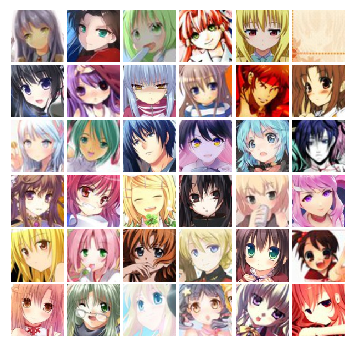

In [10]:
path = '/home/lw2435/faces'
fetch_amount = 200
batch_size = 36
noise_dim = 1024
log_dir='/home/lw2435' + '/DCGAN-v13'#------------------------------------------------------------------------
save_size = 36
cifar_10 = fetch_img(path,fetch_amount)

In [11]:
def attention(x,ch):
    with tf.variable_scope('attention', reuse=False):
        init = tf.contrib.layers.xavier_initializer()
        f = tf.layers.conv2d(x,filters=ch//2,kernel_size=1,strides=1,padding='same',  
                            kernel_initializer=init,name='ff_conv')
        g = tf.layers.conv2d(x,filters=ch//2,kernel_size=1,strides=1,padding='same',  
                            kernel_initializer=init,name='gg_conv')
        
        f = tf.reshape(f,shape=[f.shape[0],-1,f.shape[-1]])
        g = tf.reshape(g,shape=[g.shape[0],-1,g.shape[-1]])
        
        combine_f_g = tf.matmul(g,f,transpose_b=True)   #[batch,height,width,channel/2]
        combine_f_g = tf.nn.softmax(combine_f_g, dim=-1)#[batch,h*w,h*w]
        
        h = tf.layers.conv2d(x,filters=ch,kernel_size=1,strides=1,padding='same',  
                            kernel_initializer=init,name='hh_conv') #[batch,height,width,channel]
        h = tf.reshape(h,shape=[h.shape[0],-1,h.shape[-1]])      # [batch,h*w,channel]
        # N = h * w
        
        combine_f_g_h = tf.matmul(combine_f_g,h) # [batch,h*w,channel]
        combine_f_g_h = tf.reshape(combine_f_g_h, shape=x.shape)
        
        gamma = tf.get_variable("gamma",[1],initializer=tf.constant_initializer(0.0))
        x = gamma * combine_f_g_h + x

        return x
    
def generator(x):#for dcgan   input  [batch=128,noise_dim=1024]
    with tf.variable_scope("generator"):#zzz???????????????
        init = tf.contrib.layers.xavier_initializer()
        #reshape
        fc1 = tf.layers.dense(inputs=z,units=4*4*64,kernel_initializer=init,name='g_dense_0')  #[batch,4*4*64]#_--------------modify for all
        fc1 = tf.layers.batch_normalization(fc1,name='g_batchnorm_0')
        fc1 = tf.nn.relu(fc1)
        img = tf.reshape(fc1,[-1,4,4,64])                                              #[batch,4,4,256]   depth=256
        #deconv1
        img = tf.layers.conv2d_transpose(img,filters=32,kernel_size=4,strides=2,padding='same', #batch*8*8*32    strides=扩大几倍
                                                kernel_initializer=init,name='g_deconv_1')
        img = tf.layers.batch_normalization(img,name='g_batchnorm_1')
        img = tf.nn.relu(img)
 
        img = tf.layers.conv2d_transpose(img,filters=16,kernel_size=4,strides=2,padding='same', #batch*16*16*16
                                                kernel_initializer=init,name='g_deconv_2')
        img = tf.layers.batch_normalization(img,name='g_batchnorm_2')
        img = tf.nn.relu(img)
        
        #img = attention(img,16)
        
        img = tf.layers.conv2d_transpose(img,filters=8,kernel_size=4,strides=2,padding='same', #batch*32*32*8
                                                kernel_initializer=init,name='g_deconv_3')
        img = tf.layers.batch_normalization(img,name='g_batchnorm_3')
        img = tf.nn.relu(img)

        img = tf.layers.conv2d_transpose(img,filters=3,kernel_size=4,strides=2,padding='same', #batch*64*64*3 #-----------------------adding layer
                                                kernel_initializer=init,name='g_deconv_4')
        img = tf.layers.batch_normalization(img,name='g_batchnorm_4')
        img = tf.nn.tanh(img)  #size down is a linear function !!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!
        #img = tf.layers.conv2d_transpose(img,3,4,strides=1,padding='same', #batch*32*32*3-------------------------------------
                                                #activation=tf.nn.tanh,kernel_initializer=init,name='g_deconv_4')#-------activation

        #img = tf.layers.batch_normalization(img,name='g_batchnorm_3')
        #img = tf.nn.relu(img)
        #reshape
        #img = tf.reshape(img,[-1,64*64*3]) #[batch,] #------------------------------change size
        
        #img = tf.layers.dense(inputs=img,units=96*96*3,kernel_initializer=init,name='g_dense_5') #----------adding layer
        
        #img = img / tf.maximum(tf.abs(tf.reduce_min(img)),tf.abs(tf.reduce_max(img)))
        #img = tf.layers.dense(inputs=img,units=,activation=tf.nn.tanh,name='tanh')#---------------change para   #change output size
        img = tf.image.resize_images(img,(img_size,img_size),method=0)
        img = tf.reshape(img,shape=[-1,img_size*img_size*3])
        return img

def train(sess,G_train_step,G_loss,D_train_step,D_loss,G_extra_step,D_extra_step,
         show_every=250,print_every=50,batch_size=128,num_epoch=10):
    max_iter = int(cifar_10.shape[0]*num_epoch/batch_size)#===========================================
    offset = 0 #============================================================
    epoch_cur = 0
    for it in range(max_iter):
        if (it % show_every == 0):
            #print(sess.run(tf.reduce_max(G_sample)))
            #print(sess.run(tf.reduce_min(G_sample)))
            samples = deprocess(sess.run(G_sample))#-----------------------------take care to deprocess samples!!!
            fig = disp_images(samples[:64])# one global para
            plt.show()
            print()
        #fetch the minibatch and train
        #minibatch,minibatch_y = mnist.train.next_batch(batch_size)
        minibatch1 = cifar_10[offset : offset + batch_size]
        offset = offset + batch_size
        if (offset + batch_size >= cifar_10.shape[0]):    
            epoch_cur = epoch_cur + 1
            print("epoch:"+str(epoch_cur)+"---------------------------------")
            np.random.shuffle(cifar_10)
            offset = 0
        minibatch1 = minibatch1.reshape(minibatch1.shape[0],-1)# serialize all the pixels

        _,D_loss_curr = sess.run([D_train_step,D_loss],feed_dict = {x:minibatch1})
        _,G_loss_curr = sess.run([G_train_step,G_loss])
        #fetch the minibatch and train
        
        if (it % print_every == 0):
            print('Iter:{}, D:{:.4}, G:{:.4}'.format(it,D_loss_curr,G_loss_curr))
        if (it % show_every == 0):      
            rs = sess.run(merged,feed_dict = {x:minibatch1})#-------------------------------------------
            train_writer.add_summary(rs,it)
    print('Final images')
    samples = deprocess(sess.run(G_sample))
        
    fig = disp_images(samples[:save_size])# one global para
    plt.show()
  
def discriminator(x):#for wgan    input  [batch,32*32*3]
    with tf.variable_scope('discriminator'):
        init = tf.contrib.layers.xavier_initializer()
        
        x = tf.reshape(x,[-1,img_size*img_size*3])  #----------------------------------------change para:   [batch,96*96*3]
        #x = tf.reshape(x,[-1,img_size,img_size,3])  #generalize serialized pixels and bunch of pixels
        #x = tf.image.resize_images(x,(64,64),method=0)   #[batch,64,64,3]
        x = tf.layers.dense(x,12288,kernel_initializer=init,name='d_dense_0')#------we can never add batch normalization there
                                                                                #!!!!!!!!!!for down sample
        x = activation(x)
        
        x = tf.reshape(x,[-1,64,64,3])# one global para
        x = tf.layers.conv2d(x,filters=8,kernel_size=4,strides=2,padding='same',  #batch*32*32*8
                            kernel_initializer=init,name='d_conv_1')
        x = tf.layers.batch_normalization(x,name='d_batchnorm_1')
        x = activation(x)        

        x = tf.layers.conv2d(x,filters=16,kernel_size=4,strides=2,padding='same',  #batch*16*16*16
                            kernel_initializer=init,name='d_conv_2')
        x = tf.layers.batch_normalization(x,name='d_batchnorm_2')
        x = activation(x)         
        
        #x = attention(x,16)
        
        x = tf.layers.conv2d(x,filters=32,kernel_size=4,strides=2,padding='same',  #batch*8*8*32
                            kernel_initializer=init,name='d_conv_3')
        x = tf.layers.batch_normalization(x,name='d_batchnorm_3')
        x = activation(x)  

        x = tf.layers.conv2d(x,filters=64,kernel_size=4,strides=2,padding='same',  #batch*4*4*64
                            kernel_initializer=init,name='d_conv_4')
        x = tf.layers.batch_normalization(x,name='d_batchnorm_4')
        x = activation(x) 
        
        x = tf.reshape(x,[-1,4*4*64])                              # [batch,(4*4*64)]
        #x = tf.layers.dense(x,1024,kernel_initializer=init,name='d_dense3')  #discriminator too strong
        logits = tf.layers.dense(x,1,kernel_initializer=init,name='logits')
        #logits = tf.nn.sigmoid(logits)
        return logits



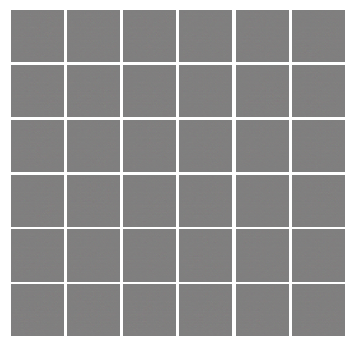


Iter:0, D:1.359, G:0.6559
epoch:1---------------------------------
Iter:5, D:1.058, G:0.556
epoch:2---------------------------------
Iter:10, D:1.293, G:0.5313
epoch:3---------------------------------
Iter:15, D:0.5412, G:0.9817
epoch:4---------------------------------
Iter:20, D:0.8413, G:0.8033
epoch:5---------------------------------
Iter:25, D:0.6978, G:0.9535
epoch:6---------------------------------
Iter:30, D:0.6645, G:1.009
epoch:7---------------------------------
Iter:35, D:0.5282, G:0.7309
epoch:8---------------------------------
Iter:40, D:0.365, G:1.332
epoch:9---------------------------------
Iter:45, D:0.3773, G:1.654
epoch:10---------------------------------
Iter:50, D:0.2928, G:1.261
epoch:11---------------------------------
Iter:55, D:1.202, G:0.8828
epoch:12---------------------------------
Iter:60, D:0.2415, G:2.257
epoch:13---------------------------------
Iter:65, D:1.542, G:1.687
epoch:14---------------------------------
Iter:70, D:0.9214, G:1.753
epoch:15--------

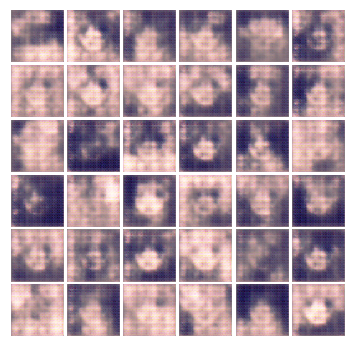


Iter:200, D:0.3343, G:2.363
epoch:41---------------------------------
Iter:205, D:0.6693, G:2.96
epoch:42---------------------------------
Iter:210, D:1.066, G:3.109
epoch:43---------------------------------
Iter:215, D:0.1376, G:2.996
epoch:44---------------------------------
Iter:220, D:0.4744, G:4.756
epoch:45---------------------------------
Iter:225, D:0.3918, G:4.07
epoch:46---------------------------------
Iter:230, D:0.1509, G:2.915
epoch:47---------------------------------
Iter:235, D:0.3911, G:3.538
epoch:48---------------------------------
Iter:240, D:1.041, G:4.947
epoch:49---------------------------------
Iter:245, D:0.4269, G:3.156
epoch:50---------------------------------
Iter:250, D:0.3709, G:2.492
epoch:51---------------------------------
Iter:255, D:0.2888, G:3.51
epoch:52---------------------------------
Iter:260, D:0.9173, G:0.8236
epoch:53---------------------------------
Iter:265, D:0.485, G:2.115
epoch:54---------------------------------
Iter:270, D:0.3966, G:1.

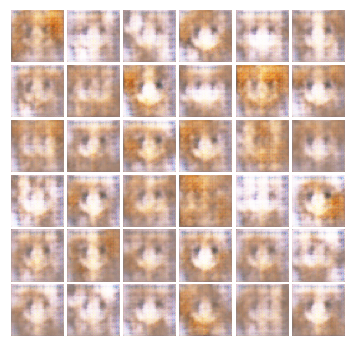


Iter:400, D:0.3102, G:2.613
epoch:81---------------------------------
Iter:405, D:2.855, G:4.206
epoch:82---------------------------------
Iter:410, D:0.4646, G:1.599
epoch:83---------------------------------
Iter:415, D:0.5998, G:2.673
epoch:84---------------------------------
Iter:420, D:0.4614, G:2.358
epoch:85---------------------------------
Iter:425, D:0.4696, G:1.829
epoch:86---------------------------------
Iter:430, D:0.3689, G:1.974
epoch:87---------------------------------
Iter:435, D:0.2815, G:1.649
epoch:88---------------------------------
Iter:440, D:0.8364, G:1.133
epoch:89---------------------------------
Iter:445, D:0.7484, G:3.511
epoch:90---------------------------------
Iter:450, D:0.7612, G:2.048
epoch:91---------------------------------
Iter:455, D:0.3774, G:3.788
epoch:92---------------------------------
Iter:460, D:0.8186, G:3.256
epoch:93---------------------------------
Iter:465, D:0.4259, G:2.329
epoch:94---------------------------------
Iter:470, D:0.4226, 

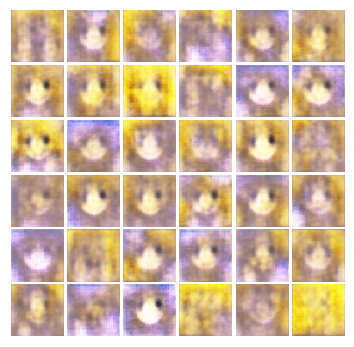


Iter:600, D:0.2365, G:3.099
epoch:121---------------------------------
Iter:605, D:0.4078, G:2.339
epoch:122---------------------------------
Iter:610, D:0.3028, G:3.382
epoch:123---------------------------------
Iter:615, D:0.9065, G:2.421
epoch:124---------------------------------
Iter:620, D:0.2562, G:2.627
epoch:125---------------------------------
Iter:625, D:0.4163, G:1.542
epoch:126---------------------------------
Iter:630, D:0.3482, G:3.263
epoch:127---------------------------------
Iter:635, D:0.1352, G:3.367
epoch:128---------------------------------
Iter:640, D:0.3159, G:3.108
epoch:129---------------------------------
Iter:645, D:0.2199, G:3.31
epoch:130---------------------------------
Iter:650, D:0.2341, G:2.656
epoch:131---------------------------------
Iter:655, D:0.1822, G:2.799
epoch:132---------------------------------
Iter:660, D:0.2967, G:2.795
epoch:133---------------------------------
Iter:665, D:0.1747, G:2.788
epoch:134---------------------------------
Iter:6

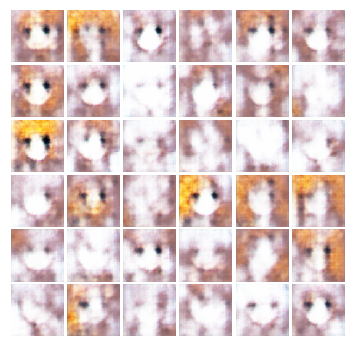


Iter:800, D:0.289, G:2.5
epoch:161---------------------------------
Iter:805, D:0.488, G:1.824
epoch:162---------------------------------
Iter:810, D:0.3284, G:2.353
epoch:163---------------------------------
Iter:815, D:0.2382, G:3.644
epoch:164---------------------------------
Iter:820, D:0.3547, G:2.88
epoch:165---------------------------------
Iter:825, D:0.7117, G:2.829
epoch:166---------------------------------
Iter:830, D:0.2864, G:2.384
epoch:167---------------------------------
Iter:835, D:0.3458, G:2.908
epoch:168---------------------------------
Iter:840, D:0.8417, G:3.401
epoch:169---------------------------------
Iter:845, D:0.218, G:2.632
epoch:170---------------------------------
Iter:850, D:0.6462, G:3.78
epoch:171---------------------------------
Iter:855, D:0.1716, G:3.086
epoch:172---------------------------------
Iter:860, D:0.549, G:3.08
epoch:173---------------------------------
Iter:865, D:0.3071, G:2.406
epoch:174---------------------------------
Iter:870, D:0.

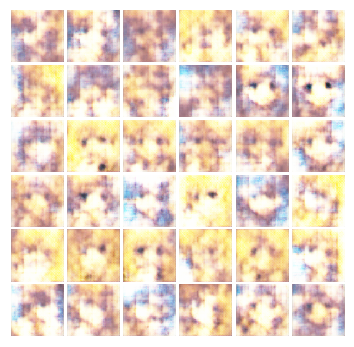


Iter:1000, D:0.2636, G:2.036
epoch:201---------------------------------
Iter:1005, D:0.3638, G:3.066
epoch:202---------------------------------
Iter:1010, D:0.2814, G:3.419
epoch:203---------------------------------
Iter:1015, D:0.4746, G:2.355
epoch:204---------------------------------
Iter:1020, D:0.2733, G:2.302
epoch:205---------------------------------
Iter:1025, D:0.3215, G:2.906
epoch:206---------------------------------
Iter:1030, D:0.2878, G:2.942
epoch:207---------------------------------
Iter:1035, D:0.04928, G:3.571
epoch:208---------------------------------
Iter:1040, D:0.1091, G:3.659
epoch:209---------------------------------
Iter:1045, D:0.2188, G:3.963
epoch:210---------------------------------
Iter:1050, D:0.2428, G:4.244
epoch:211---------------------------------
Iter:1055, D:0.3737, G:3.607
epoch:212---------------------------------
Iter:1060, D:0.1878, G:3.261
epoch:213---------------------------------
Iter:1065, D:0.06612, G:5.076
epoch:214-----------------------

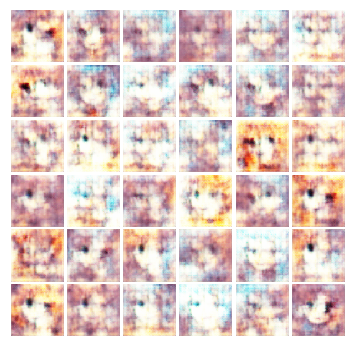


Iter:1200, D:0.2874, G:2.798
epoch:241---------------------------------
Iter:1205, D:0.1976, G:3.202
epoch:242---------------------------------
Iter:1210, D:0.1293, G:5.911
epoch:243---------------------------------
Iter:1215, D:0.1603, G:5.257
epoch:244---------------------------------
Iter:1220, D:0.08905, G:4.477
epoch:245---------------------------------
Iter:1225, D:0.09334, G:4.111
epoch:246---------------------------------
Iter:1230, D:0.03207, G:5.03
epoch:247---------------------------------
Iter:1235, D:0.2755, G:3.176
epoch:248---------------------------------
Iter:1240, D:0.2626, G:3.705
epoch:249---------------------------------
Iter:1245, D:0.306, G:2.245
epoch:250---------------------------------
Iter:1250, D:0.1237, G:3.349
epoch:251---------------------------------
Iter:1255, D:0.2257, G:3.58
epoch:252---------------------------------
Iter:1260, D:0.2938, G:3.378
epoch:253---------------------------------
Iter:1265, D:0.2153, G:3.361
epoch:254-------------------------

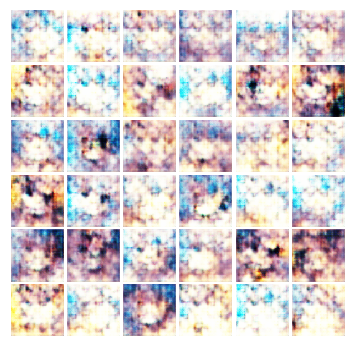


Iter:1400, D:0.03504, G:4.031
epoch:281---------------------------------
Iter:1405, D:0.1505, G:4.276
epoch:282---------------------------------
Iter:1410, D:0.05282, G:4.786
epoch:283---------------------------------
Iter:1415, D:0.3503, G:3.853
epoch:284---------------------------------
Iter:1420, D:0.6195, G:5.958
epoch:285---------------------------------
Iter:1425, D:0.2264, G:4.48
epoch:286---------------------------------
Iter:1430, D:0.1875, G:2.832
epoch:287---------------------------------
Iter:1435, D:0.05231, G:4.7
epoch:288---------------------------------
Iter:1440, D:0.07485, G:4.272
epoch:289---------------------------------
Iter:1445, D:0.02753, G:4.799
epoch:290---------------------------------
Iter:1450, D:0.1651, G:3.38
epoch:291---------------------------------
Iter:1455, D:0.1601, G:3.736
epoch:292---------------------------------
Iter:1460, D:0.07632, G:5.731
epoch:293---------------------------------
Iter:1465, D:0.1888, G:5.124
epoch:294-----------------------

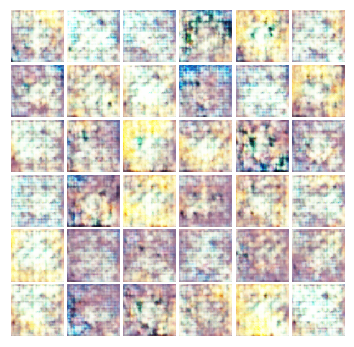


Iter:1600, D:0.04349, G:4.121
epoch:321---------------------------------
Iter:1605, D:0.1553, G:5.226
epoch:322---------------------------------
Iter:1610, D:0.2304, G:4.0
epoch:323---------------------------------
Iter:1615, D:0.07691, G:4.84
epoch:324---------------------------------
Iter:1620, D:0.02204, G:6.156
epoch:325---------------------------------
Iter:1625, D:0.02126, G:5.677
epoch:326---------------------------------
Iter:1630, D:0.04424, G:4.203
epoch:327---------------------------------
Iter:1635, D:0.02408, G:5.385
epoch:328---------------------------------
Iter:1640, D:1.79, G:9.894
epoch:329---------------------------------
Iter:1645, D:0.1754, G:3.976
epoch:330---------------------------------
Iter:1650, D:0.1548, G:4.078
epoch:331---------------------------------
Iter:1655, D:0.05126, G:4.987
epoch:332---------------------------------
Iter:1660, D:0.2202, G:3.01
epoch:333---------------------------------
Iter:1665, D:0.4366, G:3.471
epoch:334------------------------

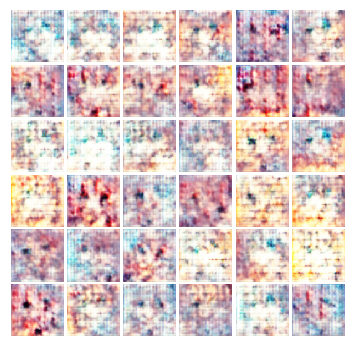


Iter:1800, D:0.1307, G:3.268
epoch:361---------------------------------
Iter:1805, D:0.04749, G:3.627
epoch:362---------------------------------
Iter:1810, D:0.1915, G:2.76
epoch:363---------------------------------
Iter:1815, D:0.187, G:3.531
epoch:364---------------------------------
Iter:1820, D:0.1096, G:5.14
epoch:365---------------------------------
Iter:1825, D:0.2502, G:7.543
epoch:366---------------------------------
Iter:1830, D:0.2683, G:2.053
epoch:367---------------------------------
Iter:1835, D:0.1855, G:4.264
epoch:368---------------------------------
Iter:1840, D:0.104, G:3.822
epoch:369---------------------------------
Iter:1845, D:0.1852, G:4.695
epoch:370---------------------------------
Iter:1850, D:0.1139, G:3.733
epoch:371---------------------------------
Iter:1855, D:0.131, G:4.41
epoch:372---------------------------------
Iter:1860, D:0.1395, G:3.699
epoch:373---------------------------------
Iter:1865, D:0.1224, G:4.063
epoch:374------------------------------

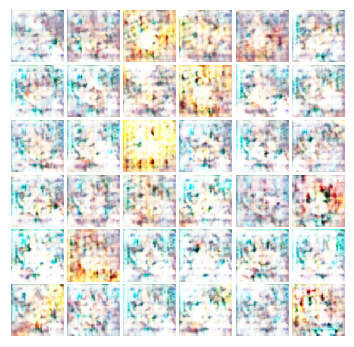


Iter:2000, D:0.01117, G:6.803
epoch:401---------------------------------
Iter:2005, D:0.1082, G:5.444
epoch:402---------------------------------
Iter:2010, D:0.1821, G:3.912
epoch:403---------------------------------
Iter:2015, D:0.02884, G:4.605
epoch:404---------------------------------
Iter:2020, D:0.03071, G:5.205
epoch:405---------------------------------
Iter:2025, D:0.1521, G:3.319
epoch:406---------------------------------
Iter:2030, D:0.0337, G:4.042
epoch:407---------------------------------
Iter:2035, D:0.09518, G:3.719
epoch:408---------------------------------
Iter:2040, D:0.006689, G:6.057
epoch:409---------------------------------
Iter:2045, D:0.07168, G:4.136
epoch:410---------------------------------
Iter:2050, D:0.007948, G:5.455
epoch:411---------------------------------
Iter:2055, D:0.04281, G:5.462
epoch:412---------------------------------
Iter:2060, D:0.003139, G:7.451
epoch:413---------------------------------
Iter:2065, D:0.02996, G:5.225
epoch:414------------

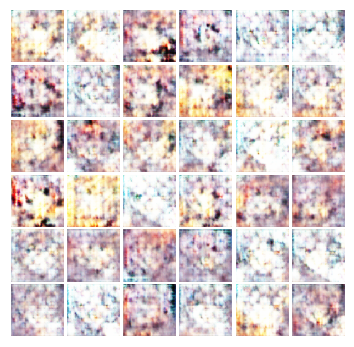


Iter:2200, D:0.09476, G:3.906
epoch:441---------------------------------
Iter:2205, D:0.2369, G:5.978
epoch:442---------------------------------
Iter:2210, D:0.1261, G:4.027
epoch:443---------------------------------
Iter:2215, D:0.2148, G:3.987
epoch:444---------------------------------
Iter:2220, D:0.1308, G:3.635
epoch:445---------------------------------
Iter:2225, D:0.2234, G:5.664
epoch:446---------------------------------
Iter:2230, D:0.1337, G:4.159
epoch:447---------------------------------
Iter:2235, D:0.09996, G:3.391
epoch:448---------------------------------
Iter:2240, D:0.3059, G:4.206
epoch:449---------------------------------
Iter:2245, D:0.1772, G:3.799
epoch:450---------------------------------
Iter:2250, D:0.1341, G:4.476
epoch:451---------------------------------
Iter:2255, D:0.08316, G:4.185
epoch:452---------------------------------
Iter:2260, D:0.103, G:3.957
epoch:453---------------------------------
Iter:2265, D:0.01268, G:5.23
epoch:454-----------------------

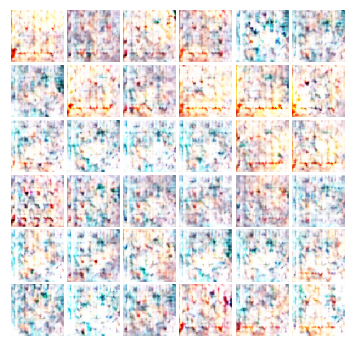


Iter:2400, D:0.02306, G:4.928
epoch:481---------------------------------
Iter:2405, D:0.02406, G:5.402
epoch:482---------------------------------
Iter:2410, D:0.01174, G:5.438
epoch:483---------------------------------
Iter:2415, D:0.0114, G:6.64
epoch:484---------------------------------
Iter:2420, D:0.198, G:3.295
epoch:485---------------------------------
Iter:2425, D:0.1998, G:5.051
epoch:486---------------------------------
Iter:2430, D:0.03271, G:5.015
epoch:487---------------------------------
Iter:2435, D:0.0989, G:4.294
epoch:488---------------------------------
Iter:2440, D:0.009054, G:5.217
epoch:489---------------------------------
Iter:2445, D:0.0376, G:5.502
epoch:490---------------------------------
Iter:2450, D:0.08566, G:3.93
epoch:491---------------------------------
Iter:2455, D:0.147, G:2.998
epoch:492---------------------------------
Iter:2460, D:0.1875, G:4.541
epoch:493---------------------------------
Iter:2465, D:0.02613, G:5.164
epoch:494---------------------

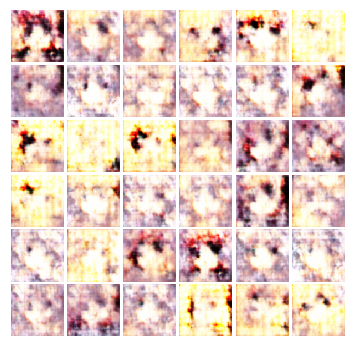


Iter:2600, D:0.2479, G:3.574
epoch:521---------------------------------
Iter:2605, D:0.2904, G:3.84
epoch:522---------------------------------
Iter:2610, D:0.6833, G:2.079
epoch:523---------------------------------
Iter:2615, D:0.1835, G:3.606
epoch:524---------------------------------
Iter:2620, D:0.216, G:3.215
epoch:525---------------------------------
Iter:2625, D:0.172, G:3.183
epoch:526---------------------------------
Iter:2630, D:0.3128, G:3.857
epoch:527---------------------------------
Iter:2635, D:0.3163, G:2.902
epoch:528---------------------------------
Iter:2640, D:0.185, G:2.927
epoch:529---------------------------------
Iter:2645, D:0.1451, G:3.025
epoch:530---------------------------------
Iter:2650, D:0.193, G:4.928
epoch:531---------------------------------
Iter:2655, D:0.2045, G:3.569
epoch:532---------------------------------
Iter:2660, D:0.2387, G:2.768
epoch:533---------------------------------
Iter:2665, D:0.0773, G:4.356
epoch:534------------------------------

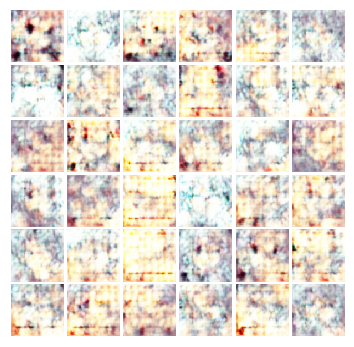


Iter:2800, D:0.09508, G:4.504
epoch:561---------------------------------
Iter:2805, D:0.1474, G:1.934
epoch:562---------------------------------
Iter:2810, D:0.5758, G:4.73
epoch:563---------------------------------
Iter:2815, D:0.2227, G:3.672
epoch:564---------------------------------
Iter:2820, D:0.203, G:3.707
epoch:565---------------------------------
Iter:2825, D:0.2377, G:2.641
epoch:566---------------------------------
Iter:2830, D:0.3891, G:2.5
epoch:567---------------------------------
Iter:2835, D:0.05913, G:4.279
epoch:568---------------------------------
Iter:2840, D:0.193, G:3.114
epoch:569---------------------------------
Iter:2845, D:0.1529, G:3.196
epoch:570---------------------------------
Iter:2850, D:0.1383, G:5.389
epoch:571---------------------------------
Iter:2855, D:0.03981, G:4.118
epoch:572---------------------------------
Iter:2860, D:0.1189, G:4.042
epoch:573---------------------------------
Iter:2865, D:0.1097, G:4.305
epoch:574---------------------------

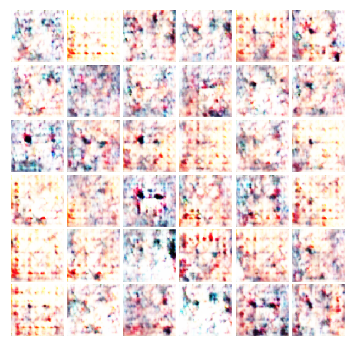


Iter:3000, D:0.01029, G:5.332
epoch:601---------------------------------
Iter:3005, D:0.02107, G:4.697
epoch:602---------------------------------
Iter:3010, D:0.1237, G:5.523
epoch:603---------------------------------
Iter:3015, D:0.09013, G:4.624
epoch:604---------------------------------
Iter:3020, D:0.09385, G:3.419
epoch:605---------------------------------
Iter:3025, D:0.01953, G:4.32
epoch:606---------------------------------
Iter:3030, D:0.04261, G:4.856
epoch:607---------------------------------
Iter:3035, D:0.03492, G:4.722
epoch:608---------------------------------
Iter:3040, D:0.07652, G:5.038
epoch:609---------------------------------
Iter:3045, D:0.002063, G:6.847
epoch:610---------------------------------
Iter:3050, D:0.05406, G:5.586
epoch:611---------------------------------
Iter:3055, D:0.001107, G:8.159
epoch:612---------------------------------
Iter:3060, D:0.008442, G:5.48
epoch:613---------------------------------
Iter:3065, D:0.01324, G:5.163
epoch:614-----------

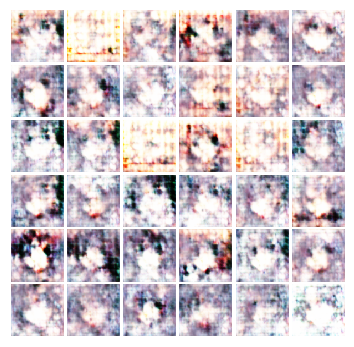


Iter:3200, D:0.4161, G:6.196
epoch:641---------------------------------
Iter:3205, D:0.201, G:3.654
epoch:642---------------------------------
Iter:3210, D:0.2008, G:3.838
epoch:643---------------------------------
Iter:3215, D:0.4083, G:3.121
epoch:644---------------------------------
Iter:3220, D:0.2074, G:3.018
epoch:645---------------------------------
Iter:3225, D:0.2582, G:2.699
epoch:646---------------------------------
Iter:3230, D:0.1551, G:4.45
epoch:647---------------------------------
Iter:3235, D:0.05771, G:4.874
epoch:648---------------------------------
Iter:3240, D:0.2899, G:2.765
epoch:649---------------------------------
Iter:3245, D:0.2684, G:4.632
epoch:650---------------------------------
Iter:3250, D:0.2029, G:3.978
epoch:651---------------------------------
Iter:3255, D:0.1155, G:3.535
epoch:652---------------------------------
Iter:3260, D:0.04262, G:4.948
epoch:653---------------------------------
Iter:3265, D:0.06303, G:4.899
epoch:654------------------------

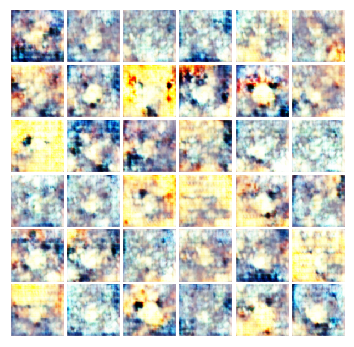


Iter:3400, D:0.9469, G:4.589
epoch:681---------------------------------
Iter:3405, D:0.5555, G:1.686
epoch:682---------------------------------
Iter:3410, D:0.2902, G:3.036
epoch:683---------------------------------
Iter:3415, D:0.1909, G:2.982
epoch:684---------------------------------
Iter:3420, D:0.1147, G:3.773
epoch:685---------------------------------
Iter:3425, D:0.2683, G:4.605
epoch:686---------------------------------
Iter:3430, D:0.1455, G:3.497
epoch:687---------------------------------
Iter:3435, D:0.07521, G:3.772
epoch:688---------------------------------
Iter:3440, D:0.09507, G:3.551
epoch:689---------------------------------
Iter:3445, D:0.03698, G:5.045
epoch:690---------------------------------
Iter:3450, D:0.302, G:2.596
epoch:691---------------------------------
Iter:3455, D:0.1388, G:4.655
epoch:692---------------------------------
Iter:3460, D:0.03158, G:5.669
epoch:693---------------------------------
Iter:3465, D:0.1568, G:3.935
epoch:694----------------------

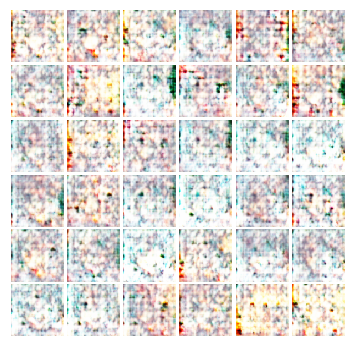


Iter:3600, D:0.1525, G:4.418
epoch:721---------------------------------
Iter:3605, D:0.00479, G:6.152
epoch:722---------------------------------
Iter:3610, D:0.1572, G:2.957
epoch:723---------------------------------
Iter:3615, D:0.1303, G:3.472
epoch:724---------------------------------
Iter:3620, D:0.004519, G:6.045
epoch:725---------------------------------
Iter:3625, D:0.5378, G:7.76
epoch:726---------------------------------
Iter:3630, D:0.03871, G:4.009
epoch:727---------------------------------
Iter:3635, D:0.2036, G:3.722
epoch:728---------------------------------
Iter:3640, D:0.1804, G:3.009
epoch:729---------------------------------
Iter:3645, D:0.09868, G:4.261
epoch:730---------------------------------
Iter:3650, D:0.1583, G:5.899
epoch:731---------------------------------
Iter:3655, D:0.00803, G:5.692
epoch:732---------------------------------
Iter:3660, D:0.1245, G:4.892
epoch:733---------------------------------
Iter:3665, D:0.04069, G:3.916
epoch:734-------------------

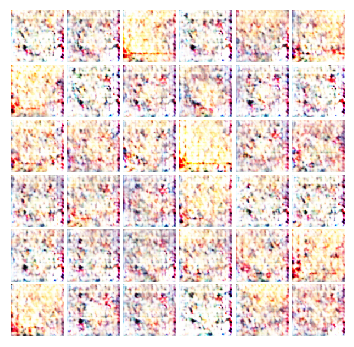


Iter:3800, D:0.1086, G:4.46
epoch:761---------------------------------
Iter:3805, D:0.1393, G:4.512
epoch:762---------------------------------
Iter:3810, D:0.009655, G:6.512
epoch:763---------------------------------
Iter:3815, D:0.1207, G:5.628
epoch:764---------------------------------
Iter:3820, D:0.05644, G:4.221
epoch:765---------------------------------
Iter:3825, D:0.003918, G:5.879
epoch:766---------------------------------
Iter:3830, D:0.02978, G:5.679
epoch:767---------------------------------
Iter:3835, D:0.1258, G:3.881
epoch:768---------------------------------
Iter:3840, D:0.00193, G:6.451
epoch:769---------------------------------
Iter:3845, D:0.01721, G:5.522
epoch:770---------------------------------
Iter:3850, D:0.06853, G:3.697
epoch:771---------------------------------
Iter:3855, D:0.001997, G:6.57
epoch:772---------------------------------
Iter:3860, D:0.005898, G:5.7
epoch:773---------------------------------
Iter:3865, D:0.009148, G:5.244
epoch:774--------------

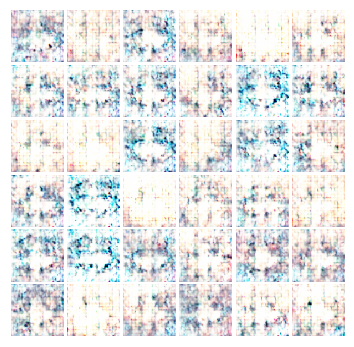


Iter:4000, D:0.1546, G:3.641
epoch:801---------------------------------
Iter:4005, D:0.1602, G:5.451
epoch:802---------------------------------
Iter:4010, D:0.2076, G:2.986
epoch:803---------------------------------
Iter:4015, D:0.2345, G:3.975
epoch:804---------------------------------
Iter:4020, D:0.1868, G:3.217
epoch:805---------------------------------
Iter:4025, D:0.1825, G:3.581
epoch:806---------------------------------
Iter:4030, D:0.1768, G:4.398
epoch:807---------------------------------
Iter:4035, D:0.1382, G:5.38
epoch:808---------------------------------
Iter:4040, D:0.03364, G:4.888
epoch:809---------------------------------
Iter:4045, D:0.1707, G:4.127
epoch:810---------------------------------
Iter:4050, D:0.107, G:3.901
epoch:811---------------------------------
Iter:4055, D:0.3379, G:3.686
epoch:812---------------------------------
Iter:4060, D:0.01912, G:5.364
epoch:813---------------------------------
Iter:4065, D:0.327, G:1.622
epoch:814--------------------------

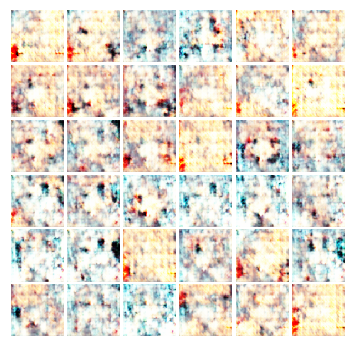


Iter:4200, D:0.1727, G:2.678
epoch:841---------------------------------
Iter:4205, D:0.06836, G:4.798
epoch:842---------------------------------
Iter:4210, D:0.2013, G:3.51
epoch:843---------------------------------
Iter:4215, D:0.06109, G:4.104
epoch:844---------------------------------
Iter:4220, D:0.08707, G:3.334
epoch:845---------------------------------
Iter:4225, D:0.2846, G:4.111
epoch:846---------------------------------
Iter:4230, D:0.108, G:5.05
epoch:847---------------------------------
Iter:4235, D:0.05529, G:4.101
epoch:848---------------------------------
Iter:4240, D:0.03776, G:4.238
epoch:849---------------------------------
Iter:4245, D:0.06683, G:4.457
epoch:850---------------------------------
Iter:4250, D:0.01995, G:4.598
epoch:851---------------------------------
Iter:4255, D:0.1332, G:4.318
epoch:852---------------------------------
Iter:4260, D:0.08027, G:3.751
epoch:853---------------------------------
Iter:4265, D:0.1647, G:2.826
epoch:854--------------------

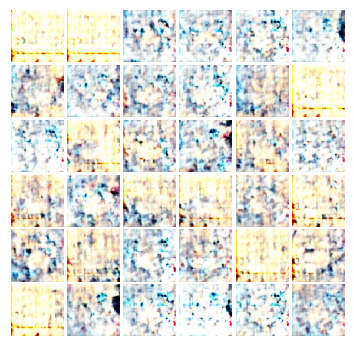


Iter:4400, D:0.07046, G:6.952
epoch:881---------------------------------
Iter:4405, D:0.1968, G:5.34
epoch:882---------------------------------
Iter:4410, D:0.07111, G:5.203
epoch:883---------------------------------
Iter:4415, D:0.009553, G:5.895
epoch:884---------------------------------
Iter:4420, D:0.1613, G:5.547
epoch:885---------------------------------
Iter:4425, D:0.009727, G:6.403
epoch:886---------------------------------
Iter:4430, D:0.05632, G:5.269
epoch:887---------------------------------
Iter:4435, D:0.06907, G:4.067
epoch:888---------------------------------
Iter:4440, D:0.01789, G:9.109
epoch:889---------------------------------
Iter:4445, D:0.03945, G:5.71
epoch:890---------------------------------
Iter:4450, D:0.02694, G:5.17
epoch:891---------------------------------
Iter:4455, D:0.1448, G:4.338
epoch:892---------------------------------
Iter:4460, D:0.008946, G:5.945
epoch:893---------------------------------
Iter:4465, D:0.005512, G:6.924
epoch:894-------------

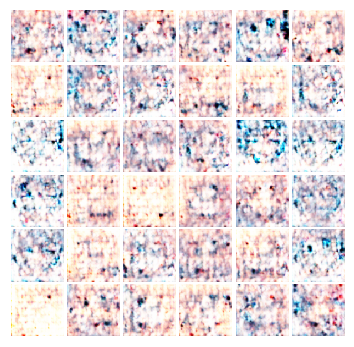


Iter:4600, D:0.1427, G:5.9
epoch:921---------------------------------
Iter:4605, D:0.03057, G:7.039
epoch:922---------------------------------
Iter:4610, D:0.6424, G:11.83
epoch:923---------------------------------
Iter:4615, D:0.02226, G:4.951
epoch:924---------------------------------
Iter:4620, D:0.046, G:4.745
epoch:925---------------------------------
Iter:4625, D:0.01647, G:5.331
epoch:926---------------------------------
Iter:4630, D:0.008205, G:5.729
epoch:927---------------------------------
Iter:4635, D:0.0683, G:4.303
epoch:928---------------------------------
Iter:4640, D:0.08336, G:3.729
epoch:929---------------------------------
Iter:4645, D:0.02146, G:5.954
epoch:930---------------------------------
Iter:4650, D:0.1132, G:5.097
epoch:931---------------------------------
Iter:4655, D:0.003937, G:6.478
epoch:932---------------------------------
Iter:4660, D:0.08669, G:3.489
epoch:933---------------------------------
Iter:4665, D:0.001642, G:6.95
epoch:934-----------------

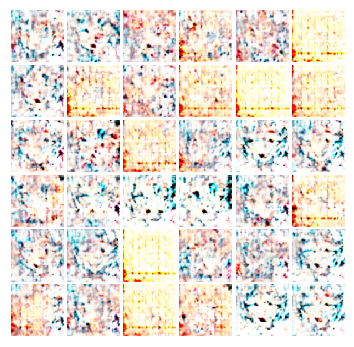


Iter:4800, D:0.1195, G:4.669
epoch:961---------------------------------
Iter:4805, D:0.1006, G:5.337
epoch:962---------------------------------
Iter:4810, D:0.111, G:4.711
epoch:963---------------------------------
Iter:4815, D:0.02261, G:5.023
epoch:964---------------------------------
Iter:4820, D:0.02463, G:4.842
epoch:965---------------------------------
Iter:4825, D:0.01436, G:5.53
epoch:966---------------------------------
Iter:4830, D:0.01606, G:5.609
epoch:967---------------------------------
Iter:4835, D:0.01627, G:4.896
epoch:968---------------------------------
Iter:4840, D:0.024, G:4.668
epoch:969---------------------------------
Iter:4845, D:0.008135, G:5.299
epoch:970---------------------------------
Iter:4850, D:0.06802, G:3.92
epoch:971---------------------------------
Iter:4855, D:0.003911, G:6.309
epoch:972---------------------------------
Iter:4860, D:0.3915, G:5.564
epoch:973---------------------------------
Iter:4865, D:0.08341, G:3.762
epoch:974------------------

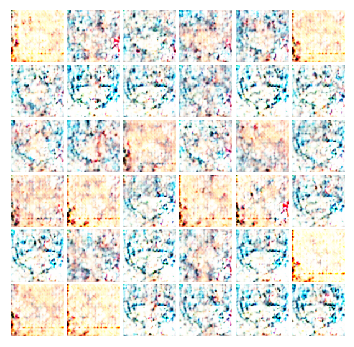


Iter:5000, D:0.02354, G:4.682
epoch:1001---------------------------------
Iter:5005, D:0.06897, G:4.769
epoch:1002---------------------------------
Iter:5010, D:0.002635, G:6.731
epoch:1003---------------------------------
Iter:5015, D:0.009958, G:5.68
epoch:1004---------------------------------
Iter:5020, D:0.03989, G:5.802
epoch:1005---------------------------------
Iter:5025, D:0.05073, G:4.882
epoch:1006---------------------------------
Iter:5030, D:0.01581, G:5.287
epoch:1007---------------------------------
Iter:5035, D:0.116, G:4.449
epoch:1008---------------------------------
Iter:5040, D:0.006245, G:5.738
epoch:1009---------------------------------
Iter:5045, D:0.06428, G:4.421
epoch:1010---------------------------------
Iter:5050, D:0.01037, G:6.007
epoch:1011---------------------------------
Iter:5055, D:0.032, G:6.132
epoch:1012---------------------------------
Iter:5060, D:0.1188, G:4.859
epoch:1013---------------------------------
Iter:5065, D:0.1082, G:4.66
epoch:1014--

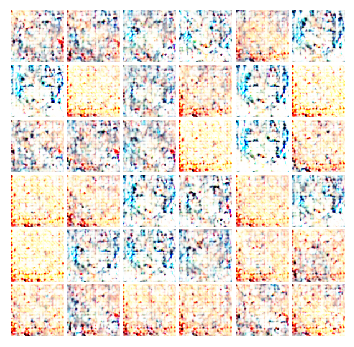


Iter:5200, D:0.008155, G:5.978
epoch:1041---------------------------------
Iter:5205, D:0.04338, G:5.525
epoch:1042---------------------------------
Iter:5210, D:0.01016, G:5.538
epoch:1043---------------------------------
Iter:5215, D:0.1208, G:4.553
epoch:1044---------------------------------
Iter:5220, D:0.001259, G:7.48
epoch:1045---------------------------------
Iter:5225, D:0.08203, G:5.235
epoch:1046---------------------------------
Iter:5230, D:0.1204, G:5.574
epoch:1047---------------------------------
Iter:5235, D:0.00421, G:7.758
epoch:1048---------------------------------
Iter:5240, D:0.03641, G:6.375
epoch:1049---------------------------------
Iter:5245, D:0.008081, G:6.561
epoch:1050---------------------------------
Iter:5250, D:0.1197, G:6.245
epoch:1051---------------------------------
Iter:5255, D:0.06586, G:4.041
epoch:1052---------------------------------
Iter:5260, D:0.07277, G:5.67
epoch:1053---------------------------------
Iter:5265, D:0.04392, G:6.409
epoch:105

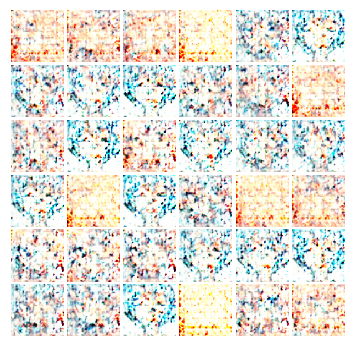


Iter:5400, D:0.002529, G:6.459
epoch:1081---------------------------------
Iter:5405, D:0.07988, G:6.165
epoch:1082---------------------------------
Iter:5410, D:0.2282, G:4.27
epoch:1083---------------------------------
Iter:5415, D:0.003344, G:6.473
epoch:1084---------------------------------
Iter:5420, D:0.1969, G:4.311
epoch:1085---------------------------------
Iter:5425, D:0.1274, G:5.076
epoch:1086---------------------------------
Iter:5430, D:0.01113, G:5.462
epoch:1087---------------------------------
Iter:5435, D:0.2402, G:3.434
epoch:1088---------------------------------
Iter:5440, D:0.1388, G:5.515
epoch:1089---------------------------------
Iter:5445, D:0.1308, G:5.118
epoch:1090---------------------------------
Iter:5450, D:0.1301, G:5.34
epoch:1091---------------------------------
Iter:5455, D:0.01988, G:4.56
epoch:1092---------------------------------
Iter:5460, D:0.006862, G:6.122
epoch:1093---------------------------------
Iter:5465, D:0.05727, G:5.769
epoch:1094----

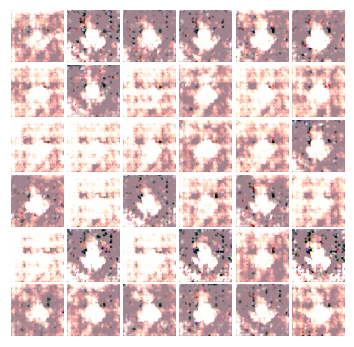


Iter:5600, D:0.6224, G:1.477
epoch:1121---------------------------------
Iter:5605, D:0.2515, G:2.864
epoch:1122---------------------------------
Iter:5610, D:0.1813, G:2.445
epoch:1123---------------------------------
Iter:5615, D:0.2123, G:3.903
epoch:1124---------------------------------
Iter:5620, D:0.1955, G:1.615
epoch:1125---------------------------------
Iter:5625, D:0.8171, G:1.573
epoch:1126---------------------------------
Iter:5630, D:0.6351, G:1.893
epoch:1127---------------------------------
Iter:5635, D:0.4114, G:2.652
epoch:1128---------------------------------
Iter:5640, D:0.3704, G:2.747
epoch:1129---------------------------------
Iter:5645, D:0.1942, G:1.581
epoch:1130---------------------------------
Iter:5650, D:0.5374, G:1.609
epoch:1131---------------------------------
Iter:5655, D:0.3224, G:2.289
epoch:1132---------------------------------
Iter:5660, D:0.2842, G:2.854
epoch:1133---------------------------------
Iter:5665, D:0.09177, G:3.851
epoch:1134----------

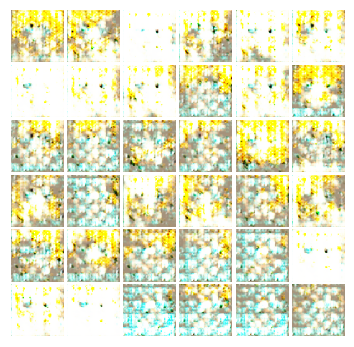


Iter:5800, D:0.1817, G:3.65
epoch:1161---------------------------------
Iter:5805, D:0.7391, G:5.167
epoch:1162---------------------------------
Iter:5810, D:0.282, G:3.211
epoch:1163---------------------------------
Iter:5815, D:0.1613, G:3.537
epoch:1164---------------------------------
Iter:5820, D:0.1192, G:4.459
epoch:1165---------------------------------
Iter:5825, D:0.2444, G:2.605
epoch:1166---------------------------------
Iter:5830, D:0.1448, G:3.95
epoch:1167---------------------------------
Iter:5835, D:0.06708, G:5.458
epoch:1168---------------------------------
Iter:5840, D:0.1201, G:6.545
epoch:1169---------------------------------
Iter:5845, D:0.5607, G:5.825
epoch:1170---------------------------------
Iter:5850, D:0.1887, G:4.453
epoch:1171---------------------------------
Iter:5855, D:0.332, G:4.232
epoch:1172---------------------------------
Iter:5860, D:0.1861, G:3.24
epoch:1173---------------------------------
Iter:5865, D:0.5741, G:4.214
epoch:1174---------------

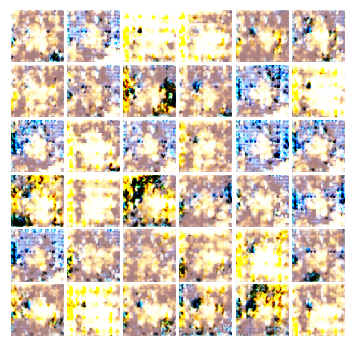


Iter:6000, D:0.274, G:3.535
epoch:1201---------------------------------
Iter:6005, D:0.06974, G:4.776
epoch:1202---------------------------------
Iter:6010, D:0.1418, G:3.253
epoch:1203---------------------------------
Iter:6015, D:0.08661, G:4.607
epoch:1204---------------------------------
Iter:6020, D:0.07793, G:4.024
epoch:1205---------------------------------
Iter:6025, D:0.05526, G:6.367
epoch:1206---------------------------------
Iter:6030, D:0.2565, G:2.818
epoch:1207---------------------------------
Iter:6035, D:0.1619, G:5.024
epoch:1208---------------------------------
Iter:6040, D:0.07211, G:4.72
epoch:1209---------------------------------
Iter:6045, D:0.0593, G:6.03
epoch:1210---------------------------------
Iter:6050, D:0.07988, G:5.915
epoch:1211---------------------------------
Iter:6055, D:0.05014, G:5.349
epoch:1212---------------------------------
Iter:6060, D:0.08638, G:4.552
epoch:1213---------------------------------
Iter:6065, D:0.04258, G:4.753
epoch:1214-----

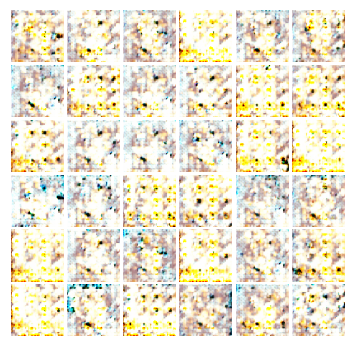


Iter:6200, D:0.06512, G:4.317
epoch:1241---------------------------------
Iter:6205, D:0.1414, G:14.1
epoch:1242---------------------------------
Iter:6210, D:0.01122, G:5.343
epoch:1243---------------------------------
Iter:6215, D:0.1184, G:4.884
epoch:1244---------------------------------
Iter:6220, D:0.02356, G:4.926
epoch:1245---------------------------------
Iter:6225, D:0.1029, G:3.77
epoch:1246---------------------------------
Iter:6230, D:0.1411, G:5.17
epoch:1247---------------------------------
Iter:6235, D:0.1, G:4.429
epoch:1248---------------------------------
Iter:6240, D:0.1096, G:4.281
epoch:1249---------------------------------
Iter:6245, D:0.015, G:6.175
epoch:1250---------------------------------
Iter:6250, D:0.02159, G:3.912
epoch:1251---------------------------------
Iter:6255, D:0.149, G:2.647
epoch:1252---------------------------------
Iter:6260, D:0.227, G:7.526
epoch:1253---------------------------------
Iter:6265, D:0.02088, G:4.798
epoch:1254---------------

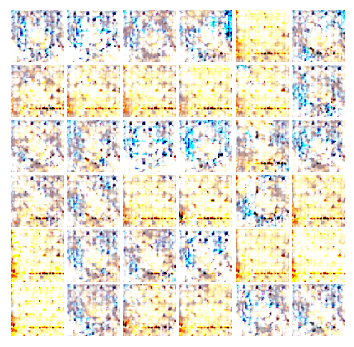


Iter:6400, D:0.01324, G:6.155
epoch:1281---------------------------------
Iter:6405, D:0.003314, G:7.619
epoch:1282---------------------------------
Iter:6410, D:0.0885, G:3.938
epoch:1283---------------------------------
Iter:6415, D:0.01506, G:5.678
epoch:1284---------------------------------
Iter:6420, D:0.04825, G:4.133
epoch:1285---------------------------------
Iter:6425, D:0.06364, G:7.917
epoch:1286---------------------------------
Iter:6430, D:0.01334, G:4.738
epoch:1287---------------------------------
Iter:6435, D:0.03431, G:5.312
epoch:1288---------------------------------
Iter:6440, D:0.02107, G:4.505
epoch:1289---------------------------------
Iter:6445, D:0.004672, G:5.314
epoch:1290---------------------------------
Iter:6450, D:0.1254, G:4.601
epoch:1291---------------------------------
Iter:6455, D:0.1455, G:5.061
epoch:1292---------------------------------
Iter:6460, D:0.1138, G:4.592
epoch:1293---------------------------------
Iter:6465, D:0.09151, G:7.838
epoch:129

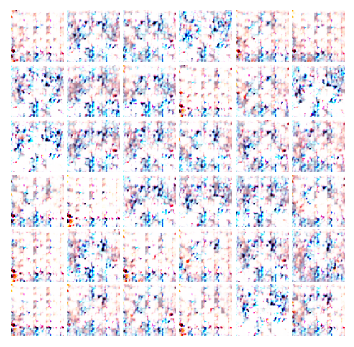


Iter:6600, D:0.01573, G:4.924
epoch:1321---------------------------------
Iter:6605, D:0.03756, G:4.443
epoch:1322---------------------------------
Iter:6610, D:0.04699, G:4.853
epoch:1323---------------------------------
Iter:6615, D:0.1257, G:4.712
epoch:1324---------------------------------
Iter:6620, D:0.04072, G:5.412
epoch:1325---------------------------------
Iter:6625, D:0.1563, G:4.789
epoch:1326---------------------------------
Iter:6630, D:0.02452, G:4.443
epoch:1327---------------------------------
Iter:6635, D:0.009141, G:5.652
epoch:1328---------------------------------
Iter:6640, D:0.004908, G:6.303
epoch:1329---------------------------------
Iter:6645, D:0.04783, G:5.501
epoch:1330---------------------------------
Iter:6650, D:0.1214, G:5.323
epoch:1331---------------------------------
Iter:6655, D:0.02311, G:5.288
epoch:1332---------------------------------
Iter:6660, D:0.1466, G:3.607
epoch:1333---------------------------------
Iter:6665, D:0.008105, G:6.61
epoch:133

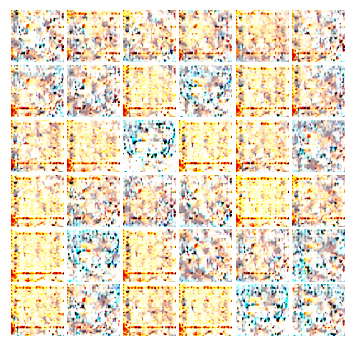


Iter:6800, D:0.001067, G:7.147
epoch:1361---------------------------------
Iter:6805, D:0.03483, G:4.98
epoch:1362---------------------------------
Iter:6810, D:0.1304, G:3.343
epoch:1363---------------------------------
Iter:6815, D:0.001185, G:6.784
epoch:1364---------------------------------
Iter:6820, D:0.04878, G:7.153
epoch:1365---------------------------------
Iter:6825, D:0.006266, G:6.65
epoch:1366---------------------------------
Iter:6830, D:0.0202, G:5.006
epoch:1367---------------------------------
Iter:6835, D:0.0406, G:4.746
epoch:1368---------------------------------
Iter:6840, D:0.02706, G:5.187
epoch:1369---------------------------------
Iter:6845, D:0.01397, G:4.858
epoch:1370---------------------------------
Iter:6850, D:0.09215, G:4.312
epoch:1371---------------------------------
Iter:6855, D:0.007279, G:5.604
epoch:1372---------------------------------
Iter:6860, D:0.01467, G:4.88
epoch:1373---------------------------------
Iter:6865, D:0.01798, G:5.53
epoch:1374

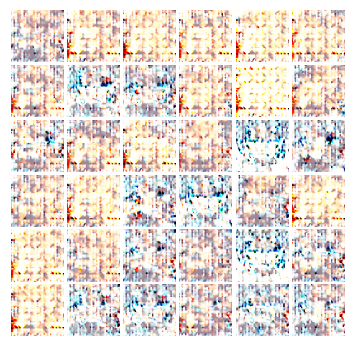


Iter:7000, D:0.006269, G:5.743
epoch:1401---------------------------------
Iter:7005, D:0.0128, G:4.994
epoch:1402---------------------------------
Iter:7010, D:0.1227, G:3.744
epoch:1403---------------------------------
Iter:7015, D:0.01816, G:5.158
epoch:1404---------------------------------
Iter:7020, D:0.06019, G:4.158
epoch:1405---------------------------------
Iter:7025, D:0.008027, G:5.175
epoch:1406---------------------------------
Iter:7030, D:0.04604, G:6.643
epoch:1407---------------------------------
Iter:7035, D:0.01281, G:4.968
epoch:1408---------------------------------
Iter:7040, D:0.09243, G:4.641
epoch:1409---------------------------------
Iter:7045, D:0.01464, G:5.06
epoch:1410---------------------------------
Iter:7050, D:0.01347, G:5.223
epoch:1411---------------------------------
Iter:7055, D:0.1614, G:3.551
epoch:1412---------------------------------
Iter:7060, D:0.04348, G:6.139
epoch:1413---------------------------------
Iter:7065, D:0.2595, G:3.52
epoch:1414-

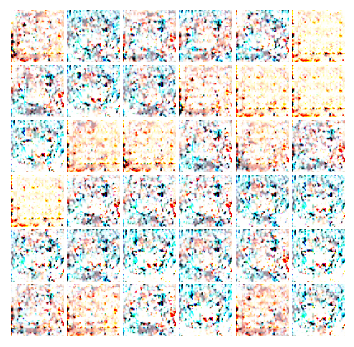


Iter:7200, D:0.08692, G:5.122
epoch:1441---------------------------------
Iter:7205, D:0.008334, G:5.575
epoch:1442---------------------------------
Iter:7210, D:0.01613, G:5.706
epoch:1443---------------------------------
Iter:7215, D:0.02281, G:3.97
epoch:1444---------------------------------
Iter:7220, D:0.09223, G:4.262
epoch:1445---------------------------------
Iter:7225, D:0.02212, G:4.257
epoch:1446---------------------------------
Iter:7230, D:0.06215, G:5.314
epoch:1447---------------------------------
Iter:7235, D:0.003185, G:6.185
epoch:1448---------------------------------
Iter:7240, D:0.06095, G:6.35
epoch:1449---------------------------------
Iter:7245, D:0.01067, G:5.291
epoch:1450---------------------------------
Iter:7250, D:0.1492, G:6.269
epoch:1451---------------------------------
Iter:7255, D:0.01219, G:4.754
epoch:1452---------------------------------
Iter:7260, D:0.03008, G:5.143
epoch:1453---------------------------------
Iter:7265, D:0.1079, G:4.465
epoch:145

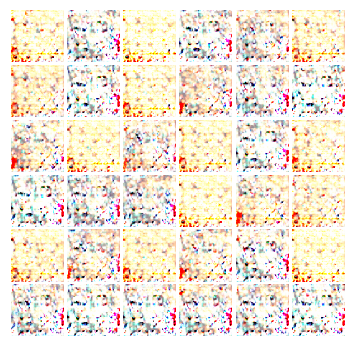


Iter:7400, D:0.004526, G:6.289
epoch:1481---------------------------------
Iter:7405, D:0.09868, G:3.38
epoch:1482---------------------------------
Iter:7410, D:0.1549, G:5.679
epoch:1483---------------------------------
Iter:7415, D:0.01844, G:4.844
epoch:1484---------------------------------
Iter:7420, D:0.004952, G:5.85
epoch:1485---------------------------------
Iter:7425, D:0.002033, G:6.814
epoch:1486---------------------------------
Iter:7430, D:0.005983, G:5.797
epoch:1487---------------------------------
Iter:7435, D:0.1556, G:4.975
epoch:1488---------------------------------
Iter:7440, D:0.009588, G:5.119
epoch:1489---------------------------------
Iter:7445, D:0.004412, G:6.247
epoch:1490---------------------------------
Iter:7450, D:0.01927, G:5.113
epoch:1491---------------------------------
Iter:7455, D:0.009408, G:5.865
epoch:1492---------------------------------
Iter:7460, D:0.002404, G:6.653
epoch:1493---------------------------------
Iter:7465, D:0.02116, G:5.158
epo

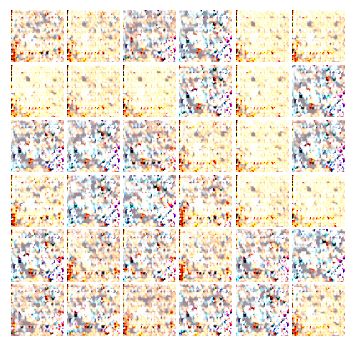


Iter:7600, D:0.00492, G:6.366
epoch:1521---------------------------------
Iter:7605, D:0.007219, G:5.416
epoch:1522---------------------------------
Iter:7610, D:0.0712, G:5.04
epoch:1523---------------------------------
Iter:7615, D:0.1798, G:6.119
epoch:1524---------------------------------
Iter:7620, D:0.01055, G:5.103
epoch:1525---------------------------------
Iter:7625, D:0.02669, G:4.71
epoch:1526---------------------------------
Iter:7630, D:0.05768, G:4.357
epoch:1527---------------------------------
Iter:7635, D:0.123, G:4.244
epoch:1528---------------------------------
Iter:7640, D:0.00241, G:6.588
epoch:1529---------------------------------
Iter:7645, D:0.1636, G:5.419
epoch:1530---------------------------------
Iter:7650, D:0.003447, G:6.359
epoch:1531---------------------------------
Iter:7655, D:0.0327, G:4.909
epoch:1532---------------------------------
Iter:7660, D:0.00859, G:6.604
epoch:1533---------------------------------
Iter:7665, D:0.01638, G:5.492
epoch:1534---

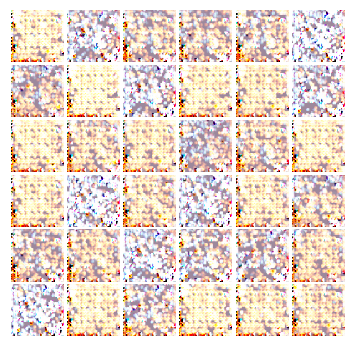


Iter:7800, D:0.2233, G:4.031
epoch:1561---------------------------------
Iter:7805, D:0.0831, G:5.824
epoch:1562---------------------------------
Iter:7810, D:0.1567, G:3.06
epoch:1563---------------------------------
Iter:7815, D:0.004301, G:5.612
epoch:1564---------------------------------
Iter:7820, D:0.002132, G:6.748
epoch:1565---------------------------------
Iter:7825, D:0.1371, G:5.508
epoch:1566---------------------------------
Iter:7830, D:0.03345, G:4.658
epoch:1567---------------------------------
Iter:7835, D:0.004311, G:5.219
epoch:1568---------------------------------
Iter:7840, D:0.001751, G:6.956
epoch:1569---------------------------------
Iter:7845, D:0.007839, G:5.933
epoch:1570---------------------------------
Iter:7850, D:0.1694, G:3.9
epoch:1571---------------------------------
Iter:7855, D:0.001282, G:7.049
epoch:1572---------------------------------
Iter:7860, D:0.04371, G:4.979
epoch:1573---------------------------------
Iter:7865, D:0.1372, G:5.319
epoch:1574

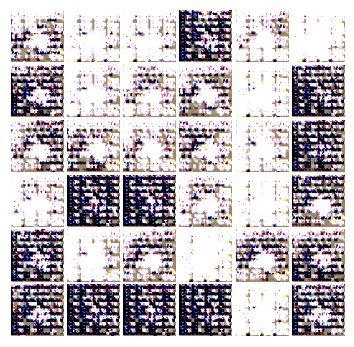


Iter:8000, D:0.1795, G:4.705
epoch:1601---------------------------------
Iter:8005, D:0.09108, G:4.965
epoch:1602---------------------------------
Iter:8010, D:0.4404, G:4.23
epoch:1603---------------------------------
Iter:8015, D:0.3013, G:4.789
epoch:1604---------------------------------
Iter:8020, D:0.2624, G:2.853
epoch:1605---------------------------------
Iter:8025, D:0.2226, G:4.544
epoch:1606---------------------------------
Iter:8030, D:0.1237, G:4.46
epoch:1607---------------------------------
Iter:8035, D:0.09902, G:5.052
epoch:1608---------------------------------
Iter:8040, D:0.1575, G:6.966
epoch:1609---------------------------------
Iter:8045, D:0.24, G:3.946
epoch:1610---------------------------------
Iter:8050, D:0.1017, G:3.749
epoch:1611---------------------------------
Iter:8055, D:0.958, G:2.631
epoch:1612---------------------------------
Iter:8060, D:0.8606, G:4.335
epoch:1613---------------------------------
Iter:8065, D:0.5417, G:2.035
epoch:1614--------------

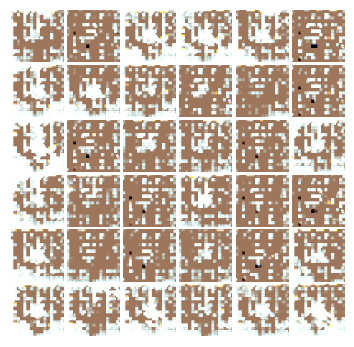


Iter:8200, D:0.06786, G:6.775
epoch:1641---------------------------------
Iter:8205, D:0.01675, G:5.524
epoch:1642---------------------------------
Iter:8210, D:0.0711, G:6.883
epoch:1643---------------------------------
Iter:8215, D:0.03538, G:6.273
epoch:1644---------------------------------
Iter:8220, D:0.01234, G:6.268
epoch:1645---------------------------------
Iter:8225, D:0.2948, G:2.666
epoch:1646---------------------------------
Iter:8230, D:0.1489, G:5.712
epoch:1647---------------------------------
Iter:8235, D:0.108, G:4.04
epoch:1648---------------------------------
Iter:8240, D:0.03596, G:4.827
epoch:1649---------------------------------
Iter:8245, D:0.04402, G:5.302
epoch:1650---------------------------------
Iter:8250, D:0.03053, G:5.295
epoch:1651---------------------------------
Iter:8255, D:0.02901, G:6.534
epoch:1652---------------------------------
Iter:8260, D:0.01189, G:8.447
epoch:1653---------------------------------
Iter:8265, D:0.4095, G:5.009
epoch:1654----

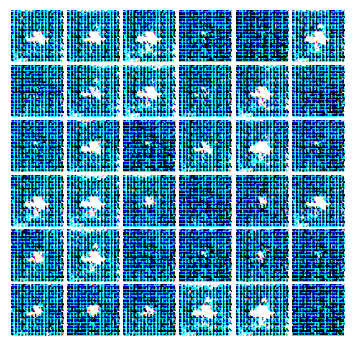


Iter:8400, D:0.007031, G:5.217
epoch:1681---------------------------------
Iter:8405, D:0.04227, G:6.024
epoch:1682---------------------------------
Iter:8410, D:0.00216, G:7.024
epoch:1683---------------------------------
Iter:8415, D:0.008542, G:6.916
epoch:1684---------------------------------
Iter:8420, D:0.3132, G:6.802
epoch:1685---------------------------------
Iter:8425, D:0.001559, G:6.806
epoch:1686---------------------------------
Iter:8430, D:0.01483, G:6.7
epoch:1687---------------------------------
Iter:8435, D:0.004019, G:5.952
epoch:1688---------------------------------
Iter:8440, D:0.04225, G:7.009
epoch:1689---------------------------------
Iter:8445, D:0.1953, G:6.186
epoch:1690---------------------------------
Iter:8450, D:0.09016, G:6.592
epoch:1691---------------------------------
Iter:8455, D:0.02729, G:5.767
epoch:1692---------------------------------
Iter:8460, D:0.2771, G:6.607
epoch:1693---------------------------------
Iter:8465, D:0.1191, G:7.363
epoch:169

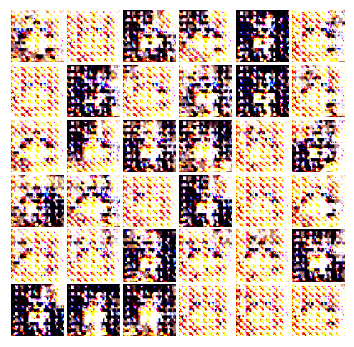


Iter:8600, D:0.01112, G:6.792
epoch:1721---------------------------------
Iter:8605, D:0.01512, G:7.942
epoch:1722---------------------------------
Iter:8610, D:0.03241, G:6.589
epoch:1723---------------------------------
Iter:8615, D:0.01799, G:9.115
epoch:1724---------------------------------
Iter:8620, D:0.1037, G:10.59
epoch:1725---------------------------------
Iter:8625, D:2.424, G:13.54
epoch:1726---------------------------------
Iter:8630, D:0.2975, G:5.56
epoch:1727---------------------------------
Iter:8635, D:0.05155, G:5.278
epoch:1728---------------------------------
Iter:8640, D:0.08004, G:5.392
epoch:1729---------------------------------
Iter:8645, D:0.06086, G:6.364
epoch:1730---------------------------------
Iter:8650, D:0.1931, G:5.858
epoch:1731---------------------------------
Iter:8655, D:0.02218, G:5.341
epoch:1732---------------------------------
Iter:8660, D:0.02105, G:4.937
epoch:1733---------------------------------
Iter:8665, D:0.04161, G:4.989
epoch:1734---

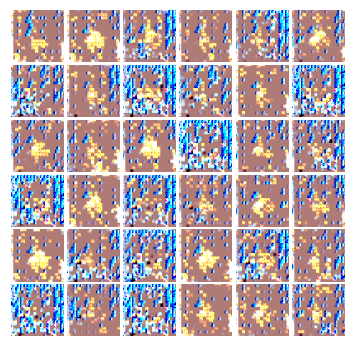


Iter:8800, D:0.07311, G:7.283
epoch:1761---------------------------------
Iter:8805, D:0.02714, G:6.476
epoch:1762---------------------------------
Iter:8810, D:0.0358, G:7.399
epoch:1763---------------------------------
Iter:8815, D:2.092, G:6.167
epoch:1764---------------------------------
Iter:8820, D:0.2798, G:3.705
epoch:1765---------------------------------
Iter:8825, D:0.3157, G:3.574
epoch:1766---------------------------------
Iter:8830, D:0.08034, G:4.222
epoch:1767---------------------------------
Iter:8835, D:0.04906, G:4.964
epoch:1768---------------------------------
Iter:8840, D:0.05313, G:5.014
epoch:1769---------------------------------
Iter:8845, D:0.07161, G:5.897
epoch:1770---------------------------------
Iter:8850, D:0.03299, G:6.069
epoch:1771---------------------------------
Iter:8855, D:0.04472, G:5.526
epoch:1772---------------------------------
Iter:8860, D:0.04399, G:4.736
epoch:1773---------------------------------
Iter:8865, D:0.03142, G:4.857
epoch:1774--

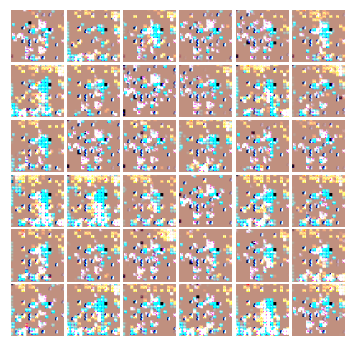


Iter:9000, D:0.00918, G:6.135
epoch:1801---------------------------------
Iter:9005, D:0.006948, G:6.148
epoch:1802---------------------------------
Iter:9010, D:0.005402, G:7.757
epoch:1803---------------------------------
Iter:9015, D:0.006865, G:5.75
epoch:1804---------------------------------
Iter:9020, D:0.002637, G:6.085
epoch:1805---------------------------------
Iter:9025, D:0.01106, G:6.767
epoch:1806---------------------------------
Iter:9030, D:0.03628, G:7.414
epoch:1807---------------------------------
Iter:9035, D:0.01028, G:6.264
epoch:1808---------------------------------
Iter:9040, D:0.01579, G:5.953
epoch:1809---------------------------------
Iter:9045, D:0.005552, G:6.917
epoch:1810---------------------------------
Iter:9050, D:0.007912, G:7.548
epoch:1811---------------------------------
Iter:9055, D:1.254, G:8.379
epoch:1812---------------------------------
Iter:9060, D:0.02425, G:4.773
epoch:1813---------------------------------
Iter:9065, D:0.0151, G:4.984
epoch

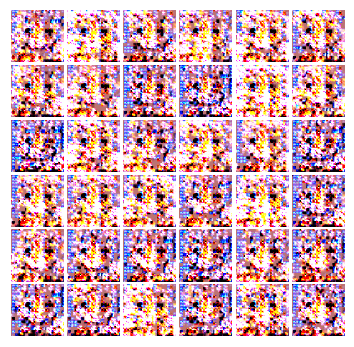


Iter:9200, D:0.001973, G:6.949
epoch:1841---------------------------------
Iter:9205, D:0.02592, G:6.948
epoch:1842---------------------------------
Iter:9210, D:0.024, G:6.528
epoch:1843---------------------------------
Iter:9215, D:0.003188, G:8.329
epoch:1844---------------------------------
Iter:9220, D:0.008337, G:6.758
epoch:1845---------------------------------
Iter:9225, D:1.13, G:24.22
epoch:1846---------------------------------
Iter:9230, D:0.001477, G:10.36
epoch:1847---------------------------------
Iter:9235, D:0.08815, G:5.768
epoch:1848---------------------------------
Iter:9240, D:0.09502, G:5.29
epoch:1849---------------------------------
Iter:9245, D:0.02129, G:5.971
epoch:1850---------------------------------
Iter:9250, D:0.02179, G:6.785
epoch:1851---------------------------------
Iter:9255, D:1.15, G:10.52
epoch:1852---------------------------------
Iter:9260, D:0.1963, G:3.919
epoch:1853---------------------------------
Iter:9265, D:0.1413, G:4.055
epoch:1854----

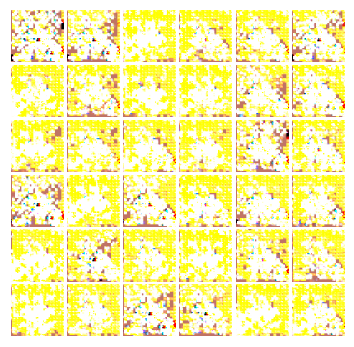


Iter:9400, D:0.03393, G:6.319
epoch:1881---------------------------------
Iter:9405, D:0.03498, G:7.818
epoch:1882---------------------------------
Iter:9410, D:0.01709, G:10.39
epoch:1883---------------------------------
Iter:9415, D:3.036, G:26.64
epoch:1884---------------------------------
Iter:9420, D:0.6714, G:1.932
epoch:1885---------------------------------
Iter:9425, D:0.2115, G:4.988
epoch:1886---------------------------------
Iter:9430, D:0.1783, G:4.592
epoch:1887---------------------------------
Iter:9435, D:0.09652, G:5.65
epoch:1888---------------------------------
Iter:9440, D:0.0622, G:5.6
epoch:1889---------------------------------
Iter:9445, D:0.03817, G:5.874
epoch:1890---------------------------------
Iter:9450, D:0.02194, G:5.819
epoch:1891---------------------------------
Iter:9455, D:0.0429, G:5.298
epoch:1892---------------------------------
Iter:9460, D:0.03626, G:5.774
epoch:1893---------------------------------
Iter:9465, D:0.02326, G:6.428
epoch:1894-------

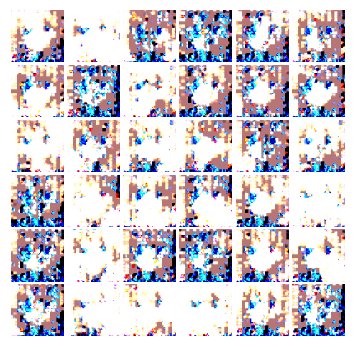


Iter:9600, D:0.02292, G:5.542
epoch:1921---------------------------------
Iter:9605, D:0.04232, G:7.039
epoch:1922---------------------------------
Iter:9610, D:0.01078, G:7.465
epoch:1923---------------------------------
Iter:9615, D:0.03619, G:9.515
epoch:1924---------------------------------
Iter:9620, D:0.0093, G:6.854
epoch:1925---------------------------------
Iter:9625, D:0.01122, G:6.148
epoch:1926---------------------------------
Iter:9630, D:0.01066, G:5.974
epoch:1927---------------------------------
Iter:9635, D:0.01726, G:6.377
epoch:1928---------------------------------
Iter:9640, D:0.02321, G:6.704
epoch:1929---------------------------------
Iter:9645, D:0.01238, G:6.184
epoch:1930---------------------------------
Iter:9650, D:0.01231, G:6.531
epoch:1931---------------------------------
Iter:9655, D:0.007567, G:6.007
epoch:1932---------------------------------
Iter:9660, D:0.0311, G:6.698
epoch:1933---------------------------------
Iter:9665, D:0.0128, G:6.474
epoch:193

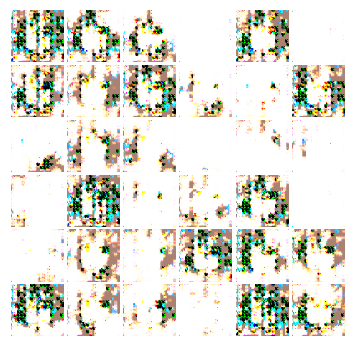


Iter:9800, D:0.08546, G:4.757
epoch:1961---------------------------------
Iter:9805, D:0.0241, G:6.353
epoch:1962---------------------------------
Iter:9810, D:0.02852, G:5.164
epoch:1963---------------------------------
Iter:9815, D:0.02218, G:6.02
epoch:1964---------------------------------
Iter:9820, D:0.02155, G:6.338
epoch:1965---------------------------------
Iter:9825, D:0.1324, G:8.059
epoch:1966---------------------------------
Iter:9830, D:0.0195, G:5.855
epoch:1967---------------------------------
Iter:9835, D:0.07152, G:5.541
epoch:1968---------------------------------
Iter:9840, D:0.006386, G:6.293
epoch:1969---------------------------------
Iter:9845, D:0.004847, G:7.23
epoch:1970---------------------------------
Iter:9850, D:0.007988, G:6.999
epoch:1971---------------------------------
Iter:9855, D:0.01199, G:6.141
epoch:1972---------------------------------
Iter:9860, D:2.867, G:17.08
epoch:1973---------------------------------
Iter:9865, D:0.1154, G:6.399
epoch:1974--

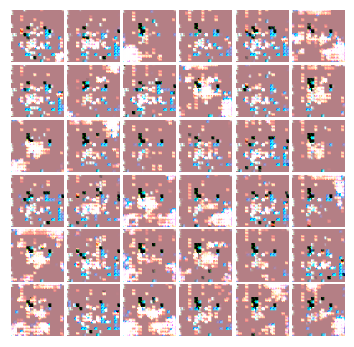


Iter:10000, D:0.02979, G:4.816
epoch:2001---------------------------------
Iter:10005, D:0.02779, G:5.439
epoch:2002---------------------------------
Iter:10010, D:0.006797, G:7.086
epoch:2003---------------------------------
Iter:10015, D:0.007014, G:6.579
epoch:2004---------------------------------
Iter:10020, D:0.02142, G:6.698
epoch:2005---------------------------------
Iter:10025, D:0.007548, G:6.321
epoch:2006---------------------------------
Iter:10030, D:0.003277, G:6.321
epoch:2007---------------------------------
Iter:10035, D:0.005097, G:7.122
epoch:2008---------------------------------
Iter:10040, D:0.02626, G:7.083
epoch:2009---------------------------------
Iter:10045, D:0.01237, G:7.618
epoch:2010---------------------------------
Iter:10050, D:0.01023, G:9.495
epoch:2011---------------------------------
Iter:10055, D:0.2465, G:18.1
epoch:2012---------------------------------
Iter:10060, D:0.002468, G:9.547
epoch:2013---------------------------------
Iter:10065, D:0.0045

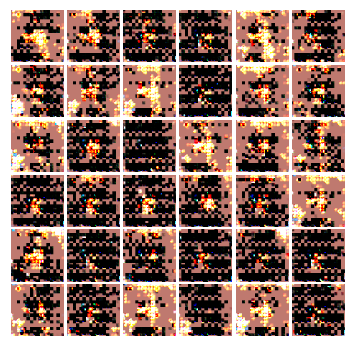


Iter:10200, D:0.006455, G:6.286
epoch:2041---------------------------------
Iter:10205, D:0.003071, G:6.584
epoch:2042---------------------------------
Iter:10210, D:0.002506, G:6.528
epoch:2043---------------------------------
Iter:10215, D:0.002163, G:6.461
epoch:2044---------------------------------
Iter:10220, D:0.01812, G:6.996
epoch:2045---------------------------------
Iter:10225, D:0.01039, G:7.45
epoch:2046---------------------------------
Iter:10230, D:0.02676, G:7.611
epoch:2047---------------------------------
Iter:10235, D:0.005172, G:6.894
epoch:2048---------------------------------
Iter:10240, D:0.1338, G:5.131
epoch:2049---------------------------------
Iter:10245, D:0.0484, G:5.855
epoch:2050---------------------------------
Iter:10250, D:0.1409, G:5.695
epoch:2051---------------------------------
Iter:10255, D:0.1506, G:3.827
epoch:2052---------------------------------
Iter:10260, D:0.3567, G:4.521
epoch:2053---------------------------------
Iter:10265, D:0.08672, G:

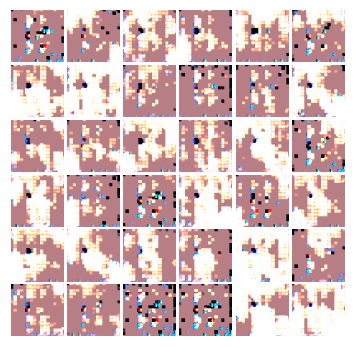


Iter:10400, D:0.1607, G:5.005
epoch:2081---------------------------------
Iter:10405, D:0.05709, G:5.473
epoch:2082---------------------------------
Iter:10410, D:0.02821, G:5.085
epoch:2083---------------------------------
Iter:10415, D:0.04497, G:4.489
epoch:2084---------------------------------
Iter:10420, D:0.2691, G:2.178
epoch:2085---------------------------------
Iter:10425, D:0.566, G:3.347
epoch:2086---------------------------------
Iter:10430, D:0.2071, G:3.55
epoch:2087---------------------------------
Iter:10435, D:0.1234, G:3.992
epoch:2088---------------------------------
Iter:10440, D:0.2227, G:1.933
epoch:2089---------------------------------
Iter:10445, D:0.3616, G:3.335
epoch:2090---------------------------------
Iter:10450, D:0.06435, G:5.243
epoch:2091---------------------------------
Iter:10455, D:0.1467, G:5.759
epoch:2092---------------------------------
Iter:10460, D:0.07788, G:4.535
epoch:2093---------------------------------
Iter:10465, D:0.05527, G:5.97
epoc

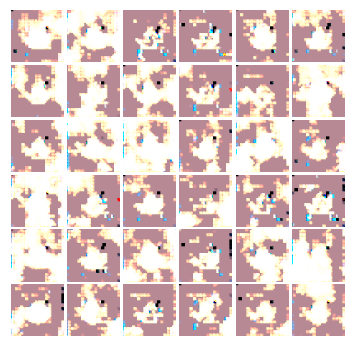


Iter:10600, D:0.09075, G:3.195
epoch:2121---------------------------------
Iter:10605, D:0.07847, G:4.205
epoch:2122---------------------------------
Iter:10610, D:0.2341, G:4.121
epoch:2123---------------------------------
Iter:10615, D:0.1597, G:1.603
epoch:2124---------------------------------
Iter:10620, D:0.08648, G:2.707
epoch:2125---------------------------------
Iter:10625, D:0.0804, G:4.015
epoch:2126---------------------------------
Iter:10630, D:0.1419, G:4.389
epoch:2127---------------------------------
Iter:10635, D:0.07862, G:4.572
epoch:2128---------------------------------
Iter:10640, D:0.02302, G:4.585
epoch:2129---------------------------------
Iter:10645, D:0.4698, G:6.217
epoch:2130---------------------------------
Iter:10650, D:0.04061, G:3.997
epoch:2131---------------------------------
Iter:10655, D:0.06438, G:4.808
epoch:2132---------------------------------
Iter:10660, D:0.03956, G:4.454
epoch:2133---------------------------------
Iter:10665, D:0.009083, G:6.1

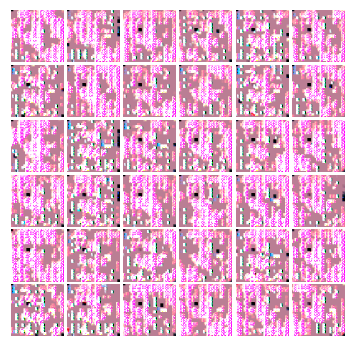


Iter:10800, D:0.009068, G:7.198
epoch:2161---------------------------------
Iter:10805, D:0.5524, G:8.705
epoch:2162---------------------------------
Iter:10810, D:0.007891, G:4.359
epoch:2163---------------------------------
Iter:10815, D:0.01426, G:5.249
epoch:2164---------------------------------
Iter:10820, D:0.01995, G:5.094
epoch:2165---------------------------------
Iter:10825, D:0.08928, G:4.763
epoch:2166---------------------------------
Iter:10830, D:0.0818, G:4.758
epoch:2167---------------------------------
Iter:10835, D:0.05279, G:5.073
epoch:2168---------------------------------
Iter:10840, D:0.2114, G:11.58
epoch:2169---------------------------------
Iter:10845, D:0.02598, G:5.407
epoch:2170---------------------------------
Iter:10850, D:0.04526, G:6.198
epoch:2171---------------------------------
Iter:10855, D:0.02933, G:6.021
epoch:2172---------------------------------
Iter:10860, D:0.03846, G:6.289
epoch:2173---------------------------------
Iter:10865, D:0.02096, G:

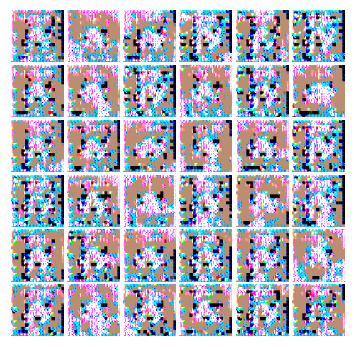


Iter:11000, D:0.004342, G:9.268
epoch:2201---------------------------------
Iter:11005, D:0.01868, G:8.665
epoch:2202---------------------------------
Iter:11010, D:0.05952, G:8.815
epoch:2203---------------------------------
Iter:11015, D:1.52, G:14.83
epoch:2204---------------------------------
Iter:11020, D:0.0003044, G:12.03
epoch:2205---------------------------------
Iter:11025, D:0.000768, G:8.239
epoch:2206---------------------------------
Iter:11030, D:0.0005366, G:8.383
epoch:2207---------------------------------
Iter:11035, D:0.000382, G:8.569
epoch:2208---------------------------------
Iter:11040, D:0.0005082, G:8.574
epoch:2209---------------------------------
Iter:11045, D:0.0009487, G:7.837
epoch:2210---------------------------------
Iter:11050, D:0.0006561, G:8.188
epoch:2211---------------------------------
Iter:11055, D:0.002297, G:7.884
epoch:2212---------------------------------
Iter:11060, D:0.001412, G:7.362
epoch:2213---------------------------------
Iter:11065, 

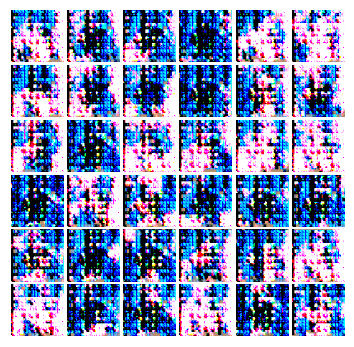


Iter:11200, D:0.000454, G:7.744
epoch:2241---------------------------------
Iter:11205, D:0.1165, G:8.475
epoch:2242---------------------------------
Iter:11210, D:0.0004797, G:8.157
epoch:2243---------------------------------
Iter:11215, D:0.0003742, G:8.295
epoch:2244---------------------------------
Iter:11220, D:0.0008469, G:8.011
epoch:2245---------------------------------
Iter:11225, D:0.0004243, G:8.094
epoch:2246---------------------------------
Iter:11230, D:0.0003821, G:7.937
epoch:2247---------------------------------
Iter:11235, D:0.001272, G:8.1
epoch:2248---------------------------------
Iter:11240, D:0.003686, G:8.122
epoch:2249---------------------------------
Iter:11245, D:0.001615, G:8.314
epoch:2250---------------------------------
Iter:11250, D:0.00455, G:8.87
epoch:2251---------------------------------
Iter:11255, D:0.01557, G:9.459
epoch:2252---------------------------------
Iter:11260, D:0.001134, G:8.203
epoch:2253---------------------------------
Iter:11265, D

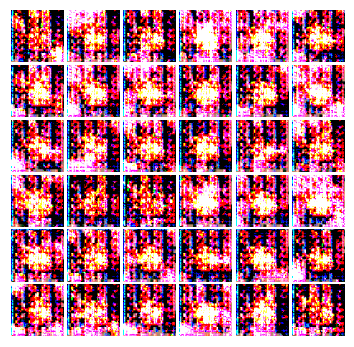


Iter:11400, D:0.01305, G:10.1
epoch:2281---------------------------------
Iter:11405, D:0.01381, G:8.547
epoch:2282---------------------------------
Iter:11410, D:0.1429, G:14.88
epoch:2283---------------------------------
Iter:11415, D:0.01907, G:9.495
epoch:2284---------------------------------
Iter:11420, D:0.02099, G:9.314
epoch:2285---------------------------------
Iter:11425, D:0.03184, G:7.46
epoch:2286---------------------------------
Iter:11430, D:0.08396, G:6.375
epoch:2287---------------------------------
Iter:11435, D:0.3589, G:10.77
epoch:2288---------------------------------
Iter:11440, D:0.1068, G:13.99
epoch:2289---------------------------------
Iter:11445, D:0.01746, G:9.884
epoch:2290---------------------------------
Iter:11450, D:0.2836, G:18.6
epoch:2291---------------------------------
Iter:11455, D:0.331, G:9.19
epoch:2292---------------------------------
Iter:11460, D:0.07433, G:8.64
epoch:2293---------------------------------
Iter:11465, D:0.03858, G:7.373
epoc

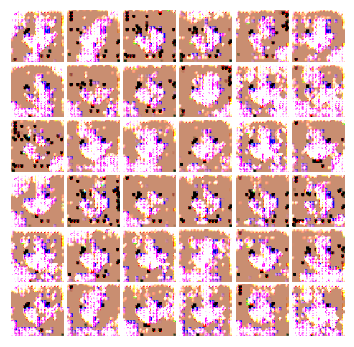


Iter:11600, D:0.004558, G:7.053
epoch:2321---------------------------------
Iter:11605, D:0.02618, G:6.881
epoch:2322---------------------------------
Iter:11610, D:0.01513, G:7.502
epoch:2323---------------------------------
Iter:11615, D:0.02071, G:6.588
epoch:2324---------------------------------
Iter:11620, D:0.06383, G:9.708
epoch:2325---------------------------------
Iter:11625, D:0.01451, G:12.94
epoch:2326---------------------------------
Iter:11630, D:0.05484, G:7.225
epoch:2327---------------------------------
Iter:11635, D:0.09062, G:9.072
epoch:2328---------------------------------
Iter:11640, D:0.01736, G:7.746
epoch:2329---------------------------------
Iter:11645, D:0.06471, G:5.733
epoch:2330---------------------------------
Iter:11650, D:0.02911, G:8.937
epoch:2331---------------------------------
Iter:11655, D:0.001928, G:10.5
epoch:2332---------------------------------
Iter:11660, D:0.003053, G:7.036
epoch:2333---------------------------------
Iter:11665, D:0.004494

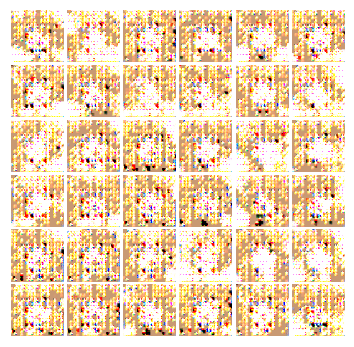


Iter:11800, D:0.1414, G:3.697
epoch:2361---------------------------------
Iter:11805, D:0.04562, G:4.119
epoch:2362---------------------------------
Iter:11810, D:0.02788, G:4.406
epoch:2363---------------------------------
Iter:11815, D:0.04543, G:4.516
epoch:2364---------------------------------
Iter:11820, D:0.03248, G:5.13
epoch:2365---------------------------------
Iter:11825, D:0.04237, G:5.424
epoch:2366---------------------------------
Iter:11830, D:0.03923, G:5.127
epoch:2367---------------------------------
Iter:11835, D:0.08739, G:5.54
epoch:2368---------------------------------
Iter:11840, D:0.04029, G:5.068
epoch:2369---------------------------------
Iter:11845, D:0.06653, G:4.767
epoch:2370---------------------------------
Iter:11850, D:0.08435, G:4.699
epoch:2371---------------------------------
Iter:11855, D:0.02712, G:5.73
epoch:2372---------------------------------
Iter:11860, D:0.1041, G:7.659
epoch:2373---------------------------------
Iter:11865, D:0.08763, G:6.08

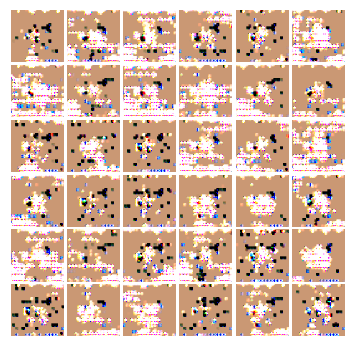


Iter:12000, D:0.01696, G:5.865
epoch:2401---------------------------------
Iter:12005, D:0.03695, G:5.335
epoch:2402---------------------------------
Iter:12010, D:0.2345, G:11.1
epoch:2403---------------------------------
Iter:12015, D:0.01372, G:9.592
epoch:2404---------------------------------
Iter:12020, D:0.007415, G:7.131
epoch:2405---------------------------------
Iter:12025, D:0.03025, G:6.293
epoch:2406---------------------------------
Iter:12030, D:0.004008, G:8.105
epoch:2407---------------------------------
Iter:12035, D:1.215, G:16.04
epoch:2408---------------------------------
Iter:12040, D:0.0486, G:5.93
epoch:2409---------------------------------
Iter:12045, D:0.05609, G:6.539
epoch:2410---------------------------------
Iter:12050, D:0.02245, G:5.635
epoch:2411---------------------------------
Iter:12055, D:0.008897, G:5.767
epoch:2412---------------------------------
Iter:12060, D:0.07502, G:5.126
epoch:2413---------------------------------
Iter:12065, D:0.01613, G:5.

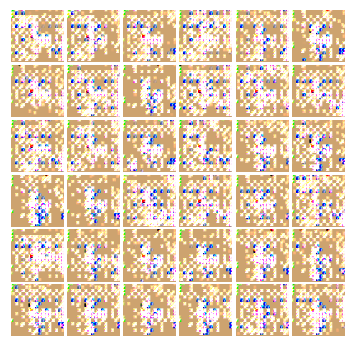


Iter:12200, D:0.005319, G:6.371
epoch:2441---------------------------------
Iter:12205, D:0.01197, G:6.644
epoch:2442---------------------------------
Iter:12210, D:0.01286, G:0.978
epoch:2443---------------------------------
Iter:12215, D:2.051, G:15.61
epoch:2444---------------------------------
Iter:12220, D:0.1576, G:3.77
epoch:2445---------------------------------
Iter:12225, D:0.07357, G:4.235
epoch:2446---------------------------------
Iter:12230, D:0.03177, G:4.858
epoch:2447---------------------------------
Iter:12235, D:0.02524, G:4.994
epoch:2448---------------------------------
Iter:12240, D:0.03491, G:5.673
epoch:2449---------------------------------
Iter:12245, D:0.03305, G:6.209
epoch:2450---------------------------------
Iter:12250, D:0.02205, G:5.272
epoch:2451---------------------------------
Iter:12255, D:0.01792, G:5.369
epoch:2452---------------------------------
Iter:12260, D:0.03008, G:5.157
epoch:2453---------------------------------
Iter:12265, D:0.0395, G:5.8

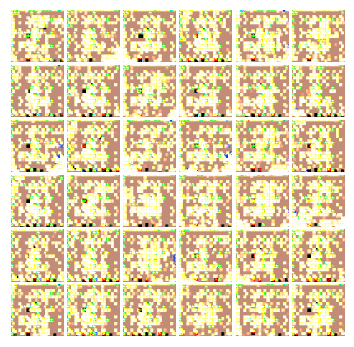


Iter:12400, D:0.02496, G:6.136
epoch:2481---------------------------------
Iter:12405, D:0.006762, G:6.114
epoch:2482---------------------------------
Iter:12410, D:0.005539, G:6.946
epoch:2483---------------------------------
Iter:12415, D:0.006847, G:9.773
epoch:2484---------------------------------
Iter:12420, D:0.005235, G:10.78
epoch:2485---------------------------------
Iter:12425, D:0.001978, G:12.77
epoch:2486---------------------------------
Iter:12430, D:0.003598, G:10.88
epoch:2487---------------------------------
Iter:12435, D:0.1366, G:20.47
epoch:2488---------------------------------
Iter:12440, D:0.09436, G:8.329
epoch:2489---------------------------------
Iter:12445, D:0.005099, G:7.712
epoch:2490---------------------------------
Iter:12450, D:0.08893, G:6.264
epoch:2491---------------------------------
Iter:12455, D:0.1148, G:10.21
epoch:2492---------------------------------
Iter:12460, D:0.06861, G:8.22
epoch:2493---------------------------------
Iter:12465, D:0.0386

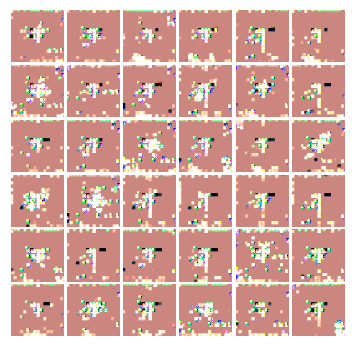


Iter:12600, D:0.04099, G:5.286
epoch:2521---------------------------------
Iter:12605, D:0.012, G:5.571
epoch:2522---------------------------------
Iter:12610, D:0.02853, G:6.073
epoch:2523---------------------------------
Iter:12615, D:0.03539, G:5.148
epoch:2524---------------------------------
Iter:12620, D:0.06761, G:6.497
epoch:2525---------------------------------
Iter:12625, D:0.02084, G:6.529
epoch:2526---------------------------------
Iter:12630, D:0.006852, G:6.392
epoch:2527---------------------------------
Iter:12635, D:0.009534, G:5.78
epoch:2528---------------------------------
Iter:12640, D:0.01125, G:7.757
epoch:2529---------------------------------
Iter:12645, D:0.1089, G:10.1
epoch:2530---------------------------------
Iter:12650, D:0.08394, G:8.103
epoch:2531---------------------------------
Iter:12655, D:0.02094, G:6.607
epoch:2532---------------------------------
Iter:12660, D:0.01351, G:7.255
epoch:2533---------------------------------
Iter:12665, D:0.004681, G:7

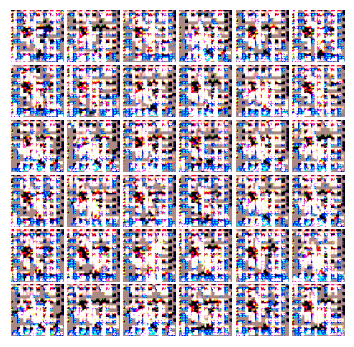


Iter:12800, D:0.00409, G:7.033
epoch:2561---------------------------------
Iter:12805, D:0.00155, G:8.776
epoch:2562---------------------------------
Iter:12810, D:0.006758, G:7.843
epoch:2563---------------------------------
Iter:12815, D:0.01764, G:4.702
epoch:2564---------------------------------
Iter:12820, D:0.2271, G:3.948
epoch:2565---------------------------------
Iter:12825, D:0.005896, G:11.52
epoch:2566---------------------------------
Iter:12830, D:0.0006899, G:8.188
epoch:2567---------------------------------
Iter:12835, D:0.001861, G:7.999
epoch:2568---------------------------------
Iter:12840, D:0.0004167, G:8.554
epoch:2569---------------------------------
Iter:12845, D:0.000371, G:8.761
epoch:2570---------------------------------
Iter:12850, D:0.001151, G:8.873
epoch:2571---------------------------------
Iter:12855, D:0.0007258, G:8.904
epoch:2572---------------------------------
Iter:12860, D:0.0004082, G:8.784
epoch:2573---------------------------------
Iter:12865, 

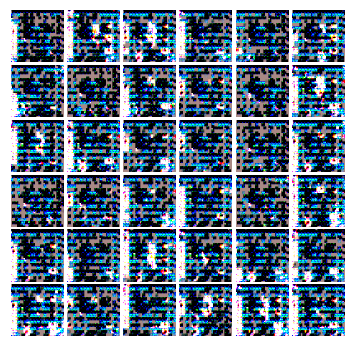


Iter:13000, D:0.0006147, G:8.921
epoch:2601---------------------------------
Iter:13005, D:0.0002723, G:8.897
epoch:2602---------------------------------
Iter:13010, D:0.0002505, G:8.91
epoch:2603---------------------------------
Iter:13015, D:0.0002676, G:8.909
epoch:2604---------------------------------
Iter:13020, D:0.0002705, G:8.934
epoch:2605---------------------------------
Iter:13025, D:0.0001859, G:9.0
epoch:2606---------------------------------
Iter:13030, D:0.0003835, G:9.022
epoch:2607---------------------------------
Iter:13035, D:0.0003996, G:9.008
epoch:2608---------------------------------
Iter:13040, D:0.0002193, G:9.042
epoch:2609---------------------------------
Iter:13045, D:0.0005999, G:9.054
epoch:2610---------------------------------
Iter:13050, D:0.0002037, G:9.116
epoch:2611---------------------------------
Iter:13055, D:0.0004502, G:9.152
epoch:2612---------------------------------
Iter:13060, D:0.0002057, G:9.13
epoch:2613---------------------------------
It

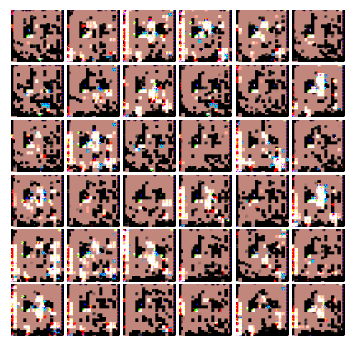


Iter:13200, D:0.0005382, G:8.118
epoch:2641---------------------------------
Iter:13205, D:0.006326, G:8.452
epoch:2642---------------------------------
Iter:13210, D:0.03945, G:9.082
epoch:2643---------------------------------
Iter:13215, D:0.03448, G:6.569
epoch:2644---------------------------------
Iter:13220, D:1.765, G:17.12
epoch:2645---------------------------------
Iter:13225, D:0.3379, G:4.502
epoch:2646---------------------------------
Iter:13230, D:0.1781, G:3.76
epoch:2647---------------------------------
Iter:13235, D:0.07557, G:4.388
epoch:2648---------------------------------
Iter:13240, D:0.09079, G:5.017
epoch:2649---------------------------------
Iter:13245, D:0.04877, G:6.922
epoch:2650---------------------------------
Iter:13250, D:0.01557, G:6.588
epoch:2651---------------------------------
Iter:13255, D:0.03235, G:5.973
epoch:2652---------------------------------
Iter:13260, D:0.05783, G:5.941
epoch:2653---------------------------------
Iter:13265, D:0.01798, G:5

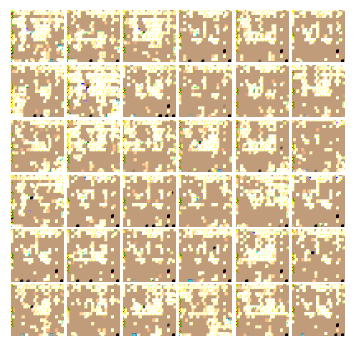


Iter:13400, D:0.001831, G:6.115
epoch:2681---------------------------------
Iter:13405, D:0.2698, G:9.246
epoch:2682---------------------------------
Iter:13410, D:0.01248, G:6.681
epoch:2683---------------------------------
Iter:13415, D:0.002674, G:6.384
epoch:2684---------------------------------
Iter:13420, D:0.006686, G:6.467
epoch:2685---------------------------------
Iter:13425, D:0.009021, G:6.864
epoch:2686---------------------------------
Iter:13430, D:0.04526, G:7.609
epoch:2687---------------------------------
Iter:13435, D:0.03645, G:6.218
epoch:2688---------------------------------
Iter:13440, D:0.01963, G:5.864
epoch:2689---------------------------------
Iter:13445, D:0.0166, G:5.671
epoch:2690---------------------------------
Iter:13450, D:0.006384, G:6.01
epoch:2691---------------------------------
Iter:13455, D:0.002918, G:6.59
epoch:2692---------------------------------
Iter:13460, D:0.00437, G:6.22
epoch:2693---------------------------------
Iter:13465, D:0.006101,

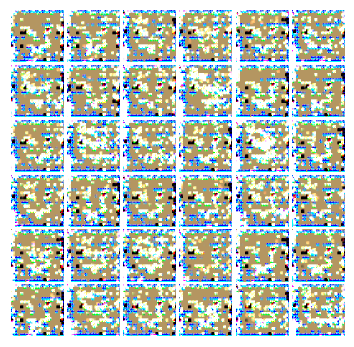


Iter:13600, D:0.004453, G:7.78
epoch:2721---------------------------------
Iter:13605, D:0.01013, G:10.05
epoch:2722---------------------------------
Iter:13610, D:0.004427, G:7.804
epoch:2723---------------------------------
Iter:13615, D:0.007202, G:7.604
epoch:2724---------------------------------
Iter:13620, D:0.007426, G:8.404
epoch:2725---------------------------------
Iter:13625, D:0.003758, G:7.729
epoch:2726---------------------------------
Iter:13630, D:0.003458, G:8.058
epoch:2727---------------------------------
Iter:13635, D:0.007511, G:8.173
epoch:2728---------------------------------
Iter:13640, D:0.2092, G:9.625
epoch:2729---------------------------------
Iter:13645, D:0.04078, G:6.842
epoch:2730---------------------------------
Iter:13650, D:0.02449, G:6.073
epoch:2731---------------------------------
Iter:13655, D:0.03067, G:5.403
epoch:2732---------------------------------
Iter:13660, D:0.01743, G:5.382
epoch:2733---------------------------------
Iter:13665, D:0.012

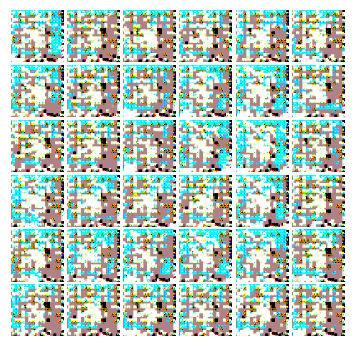


Iter:13800, D:0.003932, G:7.59
epoch:2761---------------------------------
Iter:13805, D:0.00858, G:10.1
epoch:2762---------------------------------
Iter:13810, D:0.001825, G:7.165
epoch:2763---------------------------------
Iter:13815, D:0.003839, G:8.413
epoch:2764---------------------------------
Iter:13820, D:0.004782, G:7.818
epoch:2765---------------------------------
Iter:13825, D:0.01834, G:8.127
epoch:2766---------------------------------
Iter:13830, D:0.003942, G:9.417
epoch:2767---------------------------------
Iter:13835, D:0.004565, G:7.711
epoch:2768---------------------------------
Iter:13840, D:0.01752, G:4.8
epoch:2769---------------------------------
Iter:13845, D:1.351, G:14.32
epoch:2770---------------------------------
Iter:13850, D:0.01195, G:10.33
epoch:2771---------------------------------
Iter:13855, D:0.001305, G:9.444
epoch:2772---------------------------------
Iter:13860, D:0.001563, G:10.17
epoch:2773---------------------------------
Iter:13865, D:0.002107

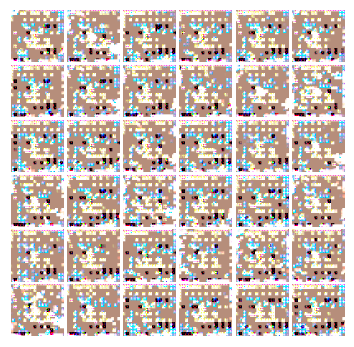


Iter:14000, D:0.007717, G:10.63
epoch:2801---------------------------------
Iter:14005, D:0.9268, G:6.371
epoch:2802---------------------------------
Iter:14010, D:0.03493, G:5.095
epoch:2803---------------------------------
Iter:14015, D:0.05764, G:4.514
epoch:2804---------------------------------
Iter:14020, D:0.2028, G:7.543
epoch:2805---------------------------------
Iter:14025, D:0.1187, G:4.566
epoch:2806---------------------------------
Iter:14030, D:0.06134, G:9.821
epoch:2807---------------------------------
Iter:14035, D:0.04286, G:6.505
epoch:2808---------------------------------
Iter:14040, D:0.03642, G:6.488
epoch:2809---------------------------------
Iter:14045, D:0.09183, G:4.327
epoch:2810---------------------------------
Iter:14050, D:0.4075, G:3.022
epoch:2811---------------------------------
Iter:14055, D:0.04642, G:4.468
epoch:2812---------------------------------
Iter:14060, D:0.02031, G:4.874
epoch:2813---------------------------------
Iter:14065, D:0.01821, G:5.

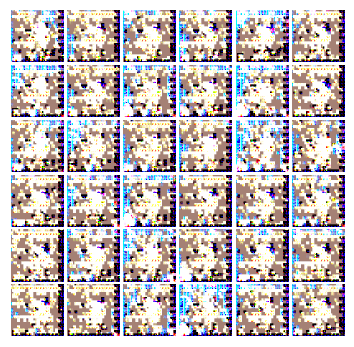


Iter:14200, D:0.002283, G:6.69
epoch:2841---------------------------------
Iter:14205, D:0.01053, G:7.917
epoch:2842---------------------------------
Iter:14210, D:0.03855, G:7.406
epoch:2843---------------------------------
Iter:14215, D:0.002899, G:7.852
epoch:2844---------------------------------
Iter:14220, D:0.001138, G:7.39
epoch:2845---------------------------------
Iter:14225, D:0.001655, G:8.127
epoch:2846---------------------------------
Iter:14230, D:0.001859, G:7.387
epoch:2847---------------------------------
Iter:14235, D:0.003612, G:6.92
epoch:2848---------------------------------
Iter:14240, D:0.003717, G:8.183
epoch:2849---------------------------------
Iter:14245, D:0.01249, G:7.929
epoch:2850---------------------------------
Iter:14250, D:0.002295, G:9.507
epoch:2851---------------------------------
Iter:14255, D:0.02183, G:8.123
epoch:2852---------------------------------
Iter:14260, D:0.007847, G:9.653
epoch:2853---------------------------------
Iter:14265, D:0.00

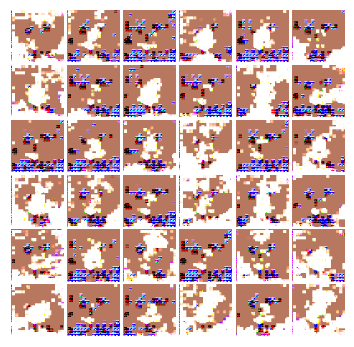


Iter:14400, D:0.01222, G:7.093
epoch:2881---------------------------------
Iter:14405, D:0.006107, G:7.265
epoch:2882---------------------------------
Iter:14410, D:0.01773, G:7.86
epoch:2883---------------------------------
Iter:14415, D:0.01638, G:7.8
epoch:2884---------------------------------
Iter:14420, D:0.02356, G:8.144
epoch:2885---------------------------------
Iter:14425, D:0.009218, G:7.54
epoch:2886---------------------------------
Iter:14430, D:0.007678, G:7.038
epoch:2887---------------------------------
Iter:14435, D:0.004286, G:8.161
epoch:2888---------------------------------
Iter:14440, D:0.3583, G:27.63
epoch:2889---------------------------------
Iter:14445, D:0.07177, G:16.48
epoch:2890---------------------------------
Iter:14450, D:0.1283, G:11.53
epoch:2891---------------------------------
Iter:14455, D:0.03782, G:8.744
epoch:2892---------------------------------
Iter:14460, D:0.008975, G:7.815
epoch:2893---------------------------------
Iter:14465, D:0.02165, G:

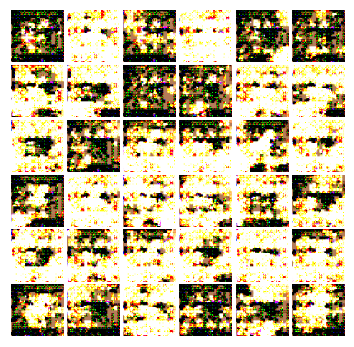


Iter:14600, D:0.03369, G:6.467
epoch:2921---------------------------------
Iter:14605, D:0.04092, G:5.905
epoch:2922---------------------------------
Iter:14610, D:0.03274, G:6.482
epoch:2923---------------------------------
Iter:14615, D:0.01179, G:6.241
epoch:2924---------------------------------
Iter:14620, D:0.01112, G:7.87
epoch:2925---------------------------------
Iter:14625, D:0.01038, G:6.423
epoch:2926---------------------------------
Iter:14630, D:0.006065, G:6.21
epoch:2927---------------------------------
Iter:14635, D:0.02085, G:7.099
epoch:2928---------------------------------
Iter:14640, D:0.02596, G:7.601
epoch:2929---------------------------------
Iter:14645, D:0.02843, G:7.945
epoch:2930---------------------------------
Iter:14650, D:0.01241, G:8.128
epoch:2931---------------------------------
Iter:14655, D:0.00476, G:7.543
epoch:2932---------------------------------
Iter:14660, D:0.003118, G:7.535
epoch:2933---------------------------------
Iter:14665, D:0.00484, G

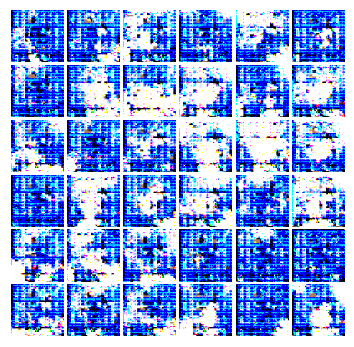


Iter:14800, D:0.001875, G:8.429
epoch:2961---------------------------------
Iter:14805, D:0.0007462, G:7.858
epoch:2962---------------------------------
Iter:14810, D:0.00221, G:8.197
epoch:2963---------------------------------
Iter:14815, D:0.0009251, G:7.586
epoch:2964---------------------------------
Iter:14820, D:0.0009307, G:7.696
epoch:2965---------------------------------
Iter:14825, D:0.0007459, G:7.987
epoch:2966---------------------------------
Iter:14830, D:0.001638, G:8.403
epoch:2967---------------------------------
Iter:14835, D:0.0002564, G:8.741
epoch:2968---------------------------------
Iter:14840, D:0.0003551, G:8.706
epoch:2969---------------------------------
Iter:14845, D:0.0005702, G:8.94
epoch:2970---------------------------------
Iter:14850, D:0.0003214, G:8.885
epoch:2971---------------------------------
Iter:14855, D:0.0004035, G:9.636
epoch:2972---------------------------------
Iter:14860, D:0.001383, G:8.931
epoch:2973---------------------------------
Iter

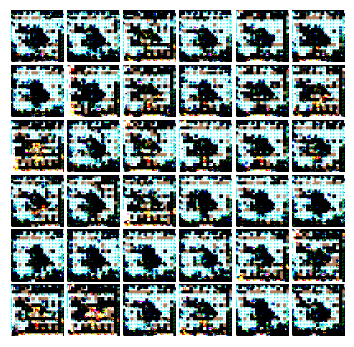


Iter:15000, D:0.0001237, G:9.957
epoch:3001---------------------------------
Iter:15005, D:0.0001222, G:9.85
epoch:3002---------------------------------
Iter:15010, D:0.0001389, G:9.753
epoch:3003---------------------------------
Iter:15015, D:0.000231, G:9.496
epoch:3004---------------------------------
Iter:15020, D:0.0001759, G:9.472
epoch:3005---------------------------------
Iter:15025, D:0.0002031, G:9.316
epoch:3006---------------------------------
Iter:15030, D:0.0004602, G:11.58
epoch:3007---------------------------------
Iter:15035, D:0.0006679, G:9.273
epoch:3008---------------------------------
Iter:15040, D:0.002477, G:11.63
epoch:3009---------------------------------
Iter:15045, D:0.0001881, G:11.2
epoch:3010---------------------------------
Iter:15050, D:0.0009221, G:11.78
epoch:3011---------------------------------
Iter:15055, D:0.02464, G:26.96
epoch:3012---------------------------------
Iter:15060, D:0.1665, G:27.63
epoch:3013---------------------------------
Iter:15

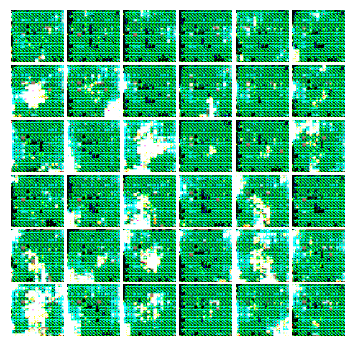


Iter:15200, D:0.0009136, G:7.142
epoch:3041---------------------------------
Iter:15205, D:0.0008698, G:8.182
epoch:3042---------------------------------
Iter:15210, D:0.001169, G:8.304
epoch:3043---------------------------------
Iter:15215, D:0.001756, G:8.564
epoch:3044---------------------------------
Iter:15220, D:0.04725, G:8.675
epoch:3045---------------------------------
Iter:15225, D:0.001416, G:7.856
epoch:3046---------------------------------
Iter:15230, D:0.007501, G:7.267
epoch:3047---------------------------------
Iter:15235, D:0.005534, G:7.967
epoch:3048---------------------------------
Iter:15240, D:0.002808, G:7.108
epoch:3049---------------------------------
Iter:15245, D:0.07883, G:8.503
epoch:3050---------------------------------
Iter:15250, D:0.007688, G:7.6
epoch:3051---------------------------------
Iter:15255, D:0.01547, G:7.845
epoch:3052---------------------------------
Iter:15260, D:0.01064, G:6.914
epoch:3053---------------------------------
Iter:15265, D:4

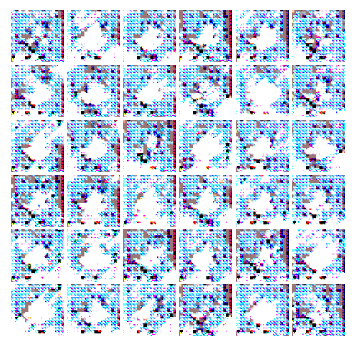


Iter:15400, D:0.04723, G:8.879
epoch:3081---------------------------------
Iter:15405, D:0.02301, G:7.602
epoch:3082---------------------------------
Iter:15410, D:0.05987, G:9.738
epoch:3083---------------------------------
Iter:15415, D:0.01059, G:9.237
epoch:3084---------------------------------
Iter:15420, D:0.004301, G:7.576
epoch:3085---------------------------------
Iter:15425, D:0.01203, G:6.314
epoch:3086---------------------------------
Iter:15430, D:0.02466, G:5.694
epoch:3087---------------------------------
Iter:15435, D:0.1316, G:20.83
epoch:3088---------------------------------
Iter:15440, D:0.2376, G:9.433
epoch:3089---------------------------------
Iter:15445, D:0.07523, G:11.63
epoch:3090---------------------------------
Iter:15450, D:0.005677, G:6.636
epoch:3091---------------------------------
Iter:15455, D:0.006657, G:7.399
epoch:3092---------------------------------
Iter:15460, D:0.008305, G:7.892
epoch:3093---------------------------------
Iter:15465, D:0.0352, 

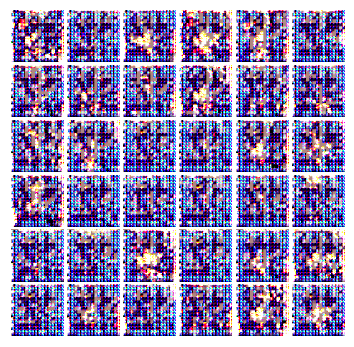


Iter:15600, D:0.0006626, G:9.666
epoch:3121---------------------------------
Iter:15605, D:0.001474, G:8.852
epoch:3122---------------------------------
Iter:15610, D:0.01946, G:10.53
epoch:3123---------------------------------
Iter:15615, D:0.0006426, G:9.574
epoch:3124---------------------------------
Iter:15620, D:0.004682, G:8.01
epoch:3125---------------------------------
Iter:15625, D:0.00282, G:9.471
epoch:3126---------------------------------
Iter:15630, D:0.0009716, G:10.02
epoch:3127---------------------------------
Iter:15635, D:0.00159, G:8.084
epoch:3128---------------------------------
Iter:15640, D:0.0006268, G:8.999
epoch:3129---------------------------------
Iter:15645, D:0.001804, G:9.086
epoch:3130---------------------------------
Iter:15650, D:0.000985, G:8.841
epoch:3131---------------------------------
Iter:15655, D:0.0009179, G:10.25
epoch:3132---------------------------------
Iter:15660, D:0.0005329, G:9.032
epoch:3133---------------------------------
Iter:1566

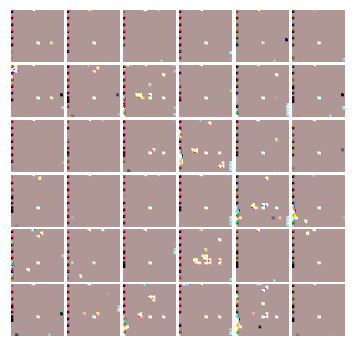


Iter:15800, D:0.009887, G:5.775
epoch:3161---------------------------------
Iter:15805, D:0.005073, G:6.103
epoch:3162---------------------------------
Iter:15810, D:0.003397, G:6.45
epoch:3163---------------------------------
Iter:15815, D:0.003788, G:6.106
epoch:3164---------------------------------
Iter:15820, D:0.01177, G:4.488
epoch:3165---------------------------------
Iter:15825, D:0.002644, G:6.835
epoch:3166---------------------------------
Iter:15830, D:0.001646, G:7.12
epoch:3167---------------------------------
Iter:15835, D:0.001919, G:6.425
epoch:3168---------------------------------
Iter:15840, D:0.002759, G:7.249
epoch:3169---------------------------------
Iter:15845, D:0.004047, G:6.793
epoch:3170---------------------------------
Iter:15850, D:0.001776, G:7.365
epoch:3171---------------------------------
Iter:15855, D:0.00169, G:7.568
epoch:3172---------------------------------
Iter:15860, D:0.001757, G:7.104
epoch:3173---------------------------------
Iter:15865, D:0

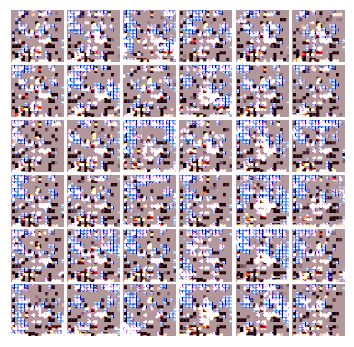


Iter:16000, D:0.00104, G:9.043
epoch:3201---------------------------------
Iter:16005, D:0.00206, G:7.803
epoch:3202---------------------------------
Iter:16010, D:0.00236, G:7.158
epoch:3203---------------------------------
Iter:16015, D:0.002121, G:7.161
epoch:3204---------------------------------
Iter:16020, D:0.003796, G:7.468
epoch:3205---------------------------------
Iter:16025, D:0.03982, G:12.14
epoch:3206---------------------------------
Iter:16030, D:0.02335, G:10.54
epoch:3207---------------------------------
Iter:16035, D:0.005305, G:9.816
epoch:3208---------------------------------
Iter:16040, D:0.00225, G:7.724
epoch:3209---------------------------------
Iter:16045, D:0.002209, G:7.845
epoch:3210---------------------------------
Iter:16050, D:0.01353, G:10.27
epoch:3211---------------------------------
Iter:16055, D:1.288, G:24.65
epoch:3212---------------------------------
Iter:16060, D:0.9992, G:14.05
epoch:3213---------------------------------
Iter:16065, D:0.05578, 

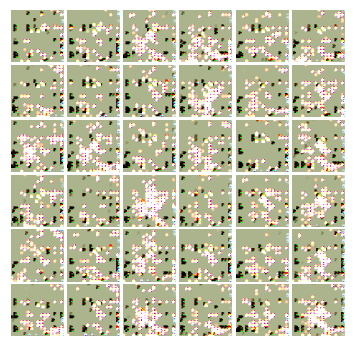


Iter:16200, D:0.01087, G:7.511
epoch:3241---------------------------------
Iter:16205, D:0.003643, G:7.318
epoch:3242---------------------------------
Iter:16210, D:0.004137, G:7.034
epoch:3243---------------------------------
Iter:16215, D:0.007213, G:6.473
epoch:3244---------------------------------
Iter:16220, D:0.04705, G:5.898
epoch:3245---------------------------------
Iter:16225, D:0.004272, G:6.299
epoch:3246---------------------------------
Iter:16230, D:0.01517, G:5.573
epoch:3247---------------------------------
Iter:16235, D:0.02545, G:5.482
epoch:3248---------------------------------
Iter:16240, D:0.009745, G:5.325
epoch:3249---------------------------------
Iter:16245, D:0.008295, G:5.708
epoch:3250---------------------------------
Iter:16250, D:0.008969, G:6.087
epoch:3251---------------------------------
Iter:16255, D:0.01384, G:6.184
epoch:3252---------------------------------
Iter:16260, D:0.008497, G:5.755
epoch:3253---------------------------------
Iter:16265, D:0.

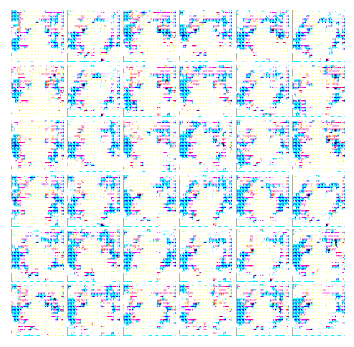


Iter:16400, D:0.006189, G:7.443
epoch:3281---------------------------------
Iter:16405, D:0.01248, G:9.068
epoch:3282---------------------------------
Iter:16410, D:0.06058, G:5.657
epoch:3283---------------------------------
Iter:16415, D:0.005104, G:8.686
epoch:3284---------------------------------
Iter:16420, D:0.01574, G:6.077
epoch:3285---------------------------------
Iter:16425, D:0.08058, G:7.621
epoch:3286---------------------------------
Iter:16430, D:0.02725, G:5.177
epoch:3287---------------------------------
Iter:16435, D:0.04083, G:6.17
epoch:3288---------------------------------
Iter:16440, D:0.01134, G:5.762
epoch:3289---------------------------------
Iter:16445, D:0.05737, G:5.868
epoch:3290---------------------------------
Iter:16450, D:0.03357, G:7.341
epoch:3291---------------------------------
Iter:16455, D:0.006554, G:6.462
epoch:3292---------------------------------
Iter:16460, D:0.002413, G:6.259
epoch:3293---------------------------------
Iter:16465, D:0.00752

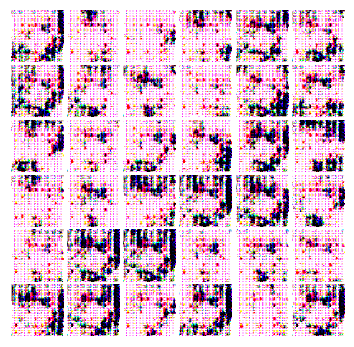


Iter:16600, D:0.008814, G:6.502
epoch:3321---------------------------------
Iter:16605, D:0.01111, G:8.39
epoch:3322---------------------------------
Iter:16610, D:0.01195, G:8.43
epoch:3323---------------------------------
Iter:16615, D:0.01349, G:7.993
epoch:3324---------------------------------
Iter:16620, D:0.03505, G:9.59
epoch:3325---------------------------------
Iter:16625, D:0.03118, G:6.334
epoch:3326---------------------------------
Iter:16630, D:0.002335, G:7.61
epoch:3327---------------------------------
Iter:16635, D:0.004961, G:7.907
epoch:3328---------------------------------
Iter:16640, D:0.004401, G:7.805
epoch:3329---------------------------------
Iter:16645, D:0.04251, G:8.692
epoch:3330---------------------------------
Iter:16650, D:0.01436, G:9.316
epoch:3331---------------------------------
Iter:16655, D:0.006156, G:8.192
epoch:3332---------------------------------
Iter:16660, D:0.003883, G:8.782
epoch:3333---------------------------------
Iter:16665, D:0.009349

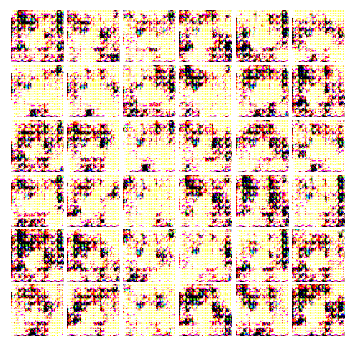


Iter:16800, D:0.002684, G:12.85
epoch:3361---------------------------------
Iter:16805, D:0.01224, G:9.177
epoch:3362---------------------------------
Iter:16810, D:0.004567, G:7.705
epoch:3363---------------------------------
Iter:16815, D:0.004834, G:7.524
epoch:3364---------------------------------
Iter:16820, D:0.001277, G:8.08
epoch:3365---------------------------------
Iter:16825, D:0.0007506, G:9.106
epoch:3366---------------------------------
Iter:16830, D:0.01587, G:9.119
epoch:3367---------------------------------
Iter:16835, D:0.002982, G:9.184
epoch:3368---------------------------------
Iter:16840, D:0.0006772, G:6.894
epoch:3369---------------------------------
Iter:16845, D:0.0001251, G:12.07
epoch:3370---------------------------------
Iter:16850, D:0.0009995, G:9.03
epoch:3371---------------------------------
Iter:16855, D:0.001846, G:9.438
epoch:3372---------------------------------
Iter:16860, D:0.002732, G:8.513
epoch:3373---------------------------------
Iter:16865,

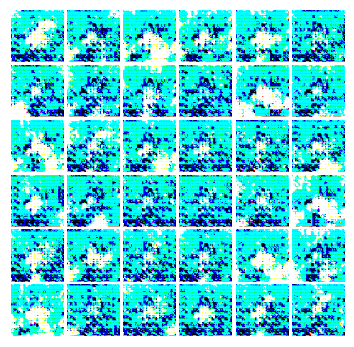


Iter:17000, D:0.0007861, G:7.887
epoch:3401---------------------------------
Iter:17005, D:0.0008457, G:8.233
epoch:3402---------------------------------
Iter:17010, D:0.00243, G:7.789
epoch:3403---------------------------------
Iter:17015, D:0.000918, G:7.921
epoch:3404---------------------------------
Iter:17020, D:0.001329, G:8.059
epoch:3405---------------------------------
Iter:17025, D:0.0005988, G:7.738
epoch:3406---------------------------------
Iter:17030, D:0.001008, G:8.179
epoch:3407---------------------------------
Iter:17035, D:0.009444, G:7.545
epoch:3408---------------------------------
Iter:17040, D:0.01246, G:8.518
epoch:3409---------------------------------
Iter:17045, D:0.004091, G:7.418
epoch:3410---------------------------------
Iter:17050, D:0.003736, G:8.036
epoch:3411---------------------------------
Iter:17055, D:0.01118, G:7.543
epoch:3412---------------------------------
Iter:17060, D:0.0351, G:7.468
epoch:3413---------------------------------
Iter:17065, D

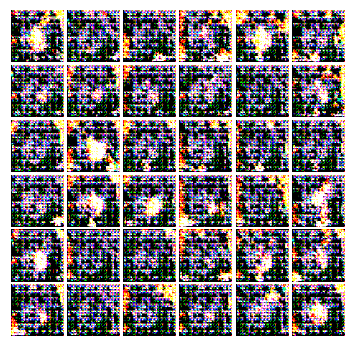


Iter:17200, D:0.0008961, G:8.019
epoch:3441---------------------------------
Iter:17205, D:0.0008098, G:8.147
epoch:3442---------------------------------
Iter:17210, D:0.0008831, G:8.254
epoch:3443---------------------------------
Iter:17215, D:0.0006781, G:7.639
epoch:3444---------------------------------
Iter:17220, D:0.0008435, G:7.709
epoch:3445---------------------------------
Iter:17225, D:0.001266, G:8.259
epoch:3446---------------------------------
Iter:17230, D:0.00046, G:10.06
epoch:3447---------------------------------
Iter:17235, D:0.1361, G:9.211
epoch:3448---------------------------------
Iter:17240, D:0.03106, G:7.961
epoch:3449---------------------------------
Iter:17245, D:0.005028, G:8.53
epoch:3450---------------------------------
Iter:17250, D:0.04378, G:8.837
epoch:3451---------------------------------
Iter:17255, D:0.03265, G:7.79
epoch:3452---------------------------------
Iter:17260, D:0.02608, G:6.134
epoch:3453---------------------------------
Iter:17265, D:0

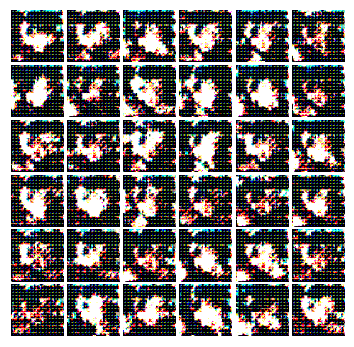


Iter:17400, D:0.008179, G:7.492
epoch:3481---------------------------------
Iter:17405, D:0.001761, G:7.916
epoch:3482---------------------------------
Iter:17410, D:0.00648, G:7.302
epoch:3483---------------------------------
Iter:17415, D:0.002645, G:7.668
epoch:3484---------------------------------
Iter:17420, D:0.001685, G:7.799
epoch:3485---------------------------------
Iter:17425, D:0.00393, G:7.805
epoch:3486---------------------------------
Iter:17430, D:0.001247, G:7.764
epoch:3487---------------------------------
Iter:17435, D:0.002092, G:9.098
epoch:3488---------------------------------
Iter:17440, D:0.000876, G:8.035
epoch:3489---------------------------------
Iter:17445, D:0.002519, G:10.24
epoch:3490---------------------------------
Iter:17450, D:0.003013, G:12.22
epoch:3491---------------------------------
Iter:17455, D:0.0008132, G:7.62
epoch:3492---------------------------------
Iter:17460, D:0.0006861, G:8.089
epoch:3493---------------------------------
Iter:17465, 

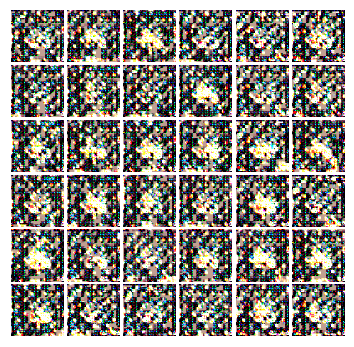


Iter:17600, D:0.001377, G:8.199
epoch:3521---------------------------------
Iter:17605, D:0.001353, G:7.745
epoch:3522---------------------------------
Iter:17610, D:0.002747, G:7.669
epoch:3523---------------------------------
Iter:17615, D:0.002043, G:9.075
epoch:3524---------------------------------
Iter:17620, D:0.002457, G:7.268
epoch:3525---------------------------------
Iter:17625, D:0.001328, G:8.943
epoch:3526---------------------------------
Iter:17630, D:0.001472, G:8.4
epoch:3527---------------------------------
Iter:17635, D:0.002211, G:8.616
epoch:3528---------------------------------
Iter:17640, D:0.001107, G:8.341
epoch:3529---------------------------------
Iter:17645, D:0.0008112, G:8.795
epoch:3530---------------------------------
Iter:17650, D:0.0008707, G:8.291
epoch:3531---------------------------------
Iter:17655, D:0.00113, G:8.74
epoch:3532---------------------------------
Iter:17660, D:0.0007824, G:8.351
epoch:3533---------------------------------
Iter:17665, 

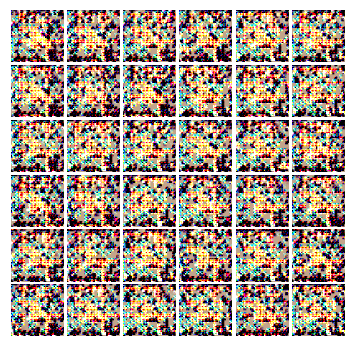


Iter:17800, D:0.0008565, G:10.2
epoch:3561---------------------------------
Iter:17805, D:1.195, G:27.63
epoch:3562---------------------------------
Iter:17810, D:1.027e-07, G:27.63
epoch:3563---------------------------------
Iter:17815, D:-0.0, G:27.63
epoch:3564---------------------------------
Iter:17820, D:1.546e-06, G:27.63
epoch:3565---------------------------------
Iter:17825, D:-0.0, G:27.63
epoch:3566---------------------------------
Iter:17830, D:-0.0, G:27.63
epoch:3567---------------------------------
Iter:17835, D:-0.0, G:27.63
epoch:3568---------------------------------
Iter:17840, D:-0.0, G:27.63
epoch:3569---------------------------------
Iter:17845, D:5.96e-08, G:27.63
epoch:3570---------------------------------
Iter:17850, D:1.51e-06, G:27.63
epoch:3571---------------------------------
Iter:17855, D:-0.0, G:27.63
epoch:3572---------------------------------
Iter:17860, D:1.5e-06, G:27.63
epoch:3573---------------------------------
Iter:17865, D:1.497e-06, G:27.63
epoc

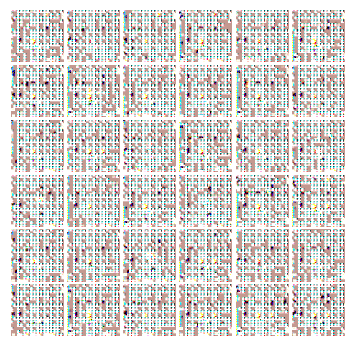


Iter:18000, D:0.00796, G:9.202
epoch:3601---------------------------------
Iter:18005, D:0.001357, G:8.498
epoch:3602---------------------------------
Iter:18010, D:0.001993, G:7.987
epoch:3603---------------------------------
Iter:18015, D:0.01097, G:9.99
epoch:3604---------------------------------
Iter:18020, D:0.3659, G:27.63
epoch:3605---------------------------------
Iter:18025, D:0.0001672, G:27.63
epoch:3606---------------------------------
Iter:18030, D:7.665e-05, G:27.63
epoch:3607---------------------------------
Iter:18035, D:1.556e-07, G:27.63
epoch:3608---------------------------------
Iter:18040, D:0.0001371, G:27.63
epoch:3609---------------------------------
Iter:18045, D:0.001443, G:27.63
epoch:3610---------------------------------
Iter:18050, D:0.001196, G:27.63
epoch:3611---------------------------------
Iter:18055, D:4.864e-05, G:27.63
epoch:3612---------------------------------
Iter:18060, D:3.941e-06, G:27.63
epoch:3613---------------------------------
Iter:18065

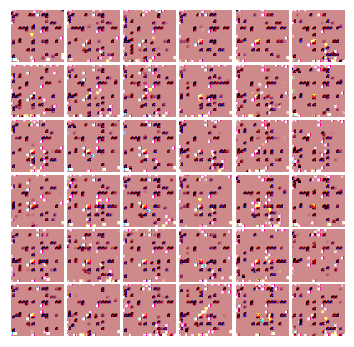


Iter:18200, D:6.623e-09, G:27.63
epoch:3641---------------------------------
Iter:18205, D:1.257e-05, G:27.63
epoch:3642---------------------------------
Iter:18210, D:2.003e-05, G:27.63
epoch:3643---------------------------------
Iter:18215, D:7.277e-06, G:27.63
epoch:3644---------------------------------
Iter:18220, D:8.688e-06, G:27.63
epoch:3645---------------------------------
Iter:18225, D:1.15e-05, G:27.63
epoch:3646---------------------------------
Iter:18230, D:0.0003317, G:27.63
epoch:3647---------------------------------
Iter:18235, D:1.014e-05, G:27.63
epoch:3648---------------------------------
Iter:18240, D:8.063e-06, G:27.63
epoch:3649---------------------------------
Iter:18245, D:2.98e-08, G:27.63
epoch:3650---------------------------------
Iter:18250, D:0.0003007, G:27.63
epoch:3651---------------------------------
Iter:18255, D:1.07e-05, G:27.63
epoch:3652---------------------------------
Iter:18260, D:7.413e-06, G:27.63
epoch:3653---------------------------------
I

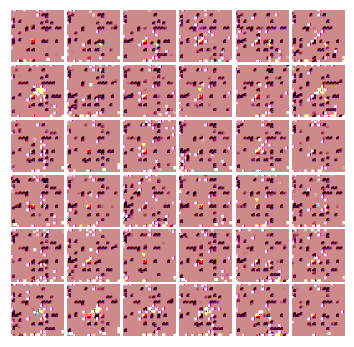


Iter:18400, D:1.411e-06, G:27.63
epoch:3681---------------------------------
Iter:18405, D:1.464e-06, G:27.63
epoch:3682---------------------------------
Iter:18410, D:6.616e-06, G:27.63
epoch:3683---------------------------------
Iter:18415, D:0.0001925, G:27.63
epoch:3684---------------------------------
Iter:18420, D:2.858e-06, G:27.63
epoch:3685---------------------------------
Iter:18425, D:4.527e-06, G:27.63
epoch:3686---------------------------------
Iter:18430, D:9.246e-06, G:27.63
epoch:3687---------------------------------
Iter:18435, D:7.819e-06, G:27.63
epoch:3688---------------------------------
Iter:18440, D:1.182e-06, G:27.63
epoch:3689---------------------------------
Iter:18445, D:1.821e-06, G:27.63
epoch:3690---------------------------------
Iter:18450, D:5.136e-06, G:27.63
epoch:3691---------------------------------
Iter:18455, D:8.45e-06, G:27.63
epoch:3692---------------------------------
Iter:18460, D:0.0001575, G:27.63
epoch:3693---------------------------------

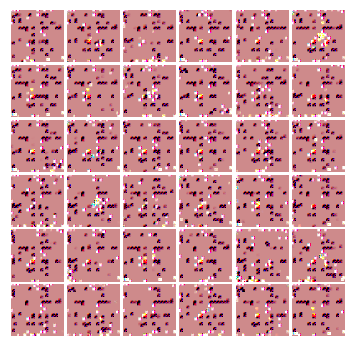


Iter:18600, D:5.593e-06, G:27.63
epoch:3721---------------------------------
Iter:18605, D:2.917e-06, G:27.63
epoch:3722---------------------------------
Iter:18610, D:4.871e-06, G:27.63
epoch:3723---------------------------------
Iter:18615, D:6.534e-06, G:27.63
epoch:3724---------------------------------
Iter:18620, D:1.391e-07, G:27.63
epoch:3725---------------------------------
Iter:18625, D:0.0001015, G:27.63
epoch:3726---------------------------------
Iter:18630, D:4.348e-06, G:27.63
epoch:3727---------------------------------
Iter:18635, D:0.0001018, G:27.63
epoch:3728---------------------------------
Iter:18640, D:2.699e-06, G:27.63
epoch:3729---------------------------------
Iter:18645, D:8.278e-08, G:27.63
epoch:3730---------------------------------
Iter:18650, D:3.311e-09, G:27.63
epoch:3731---------------------------------
Iter:18655, D:2.341e-06, G:27.63
epoch:3732---------------------------------
Iter:18660, D:7.616e-07, G:27.63
epoch:3733--------------------------------

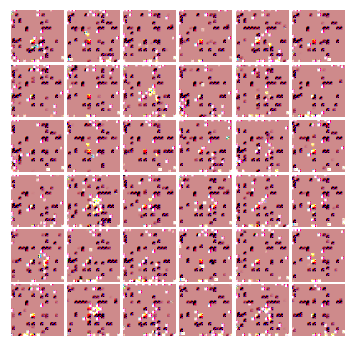


Iter:18800, D:3.311e-09, G:27.63
epoch:3761---------------------------------
Iter:18805, D:6.159e-07, G:27.63
epoch:3762---------------------------------
Iter:18810, D:1.563e-06, G:27.63
epoch:3763---------------------------------
Iter:18815, D:9.934e-09, G:27.63
epoch:3764---------------------------------
Iter:18820, D:1.589e-06, G:27.63
epoch:3765---------------------------------
Iter:18825, D:3.311e-07, G:27.63
epoch:3766---------------------------------
Iter:18830, D:3.311e-08, G:27.63
epoch:3767---------------------------------
Iter:18835, D:5.795e-07, G:27.63
epoch:3768---------------------------------
Iter:18840, D:5.857e-05, G:27.63
epoch:3769---------------------------------
Iter:18845, D:4.116e-06, G:27.63
epoch:3770---------------------------------
Iter:18850, D:2.272e-06, G:27.63
epoch:3771---------------------------------
Iter:18855, D:2.003e-06, G:27.63
epoch:3772---------------------------------
Iter:18860, D:1.977e-06, G:27.63
epoch:3773--------------------------------

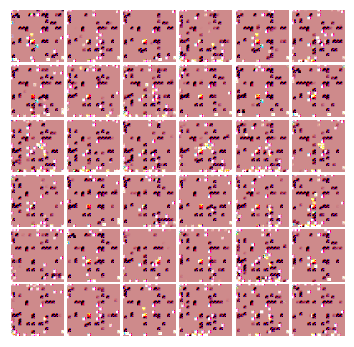


Iter:19000, D:4.341e-05, G:27.63
epoch:3801---------------------------------
Iter:19005, D:2.874e-06, G:27.63
epoch:3802---------------------------------
Iter:19010, D:1.623e-07, G:27.63
epoch:3803---------------------------------
Iter:19015, D:3.808e-07, G:27.63
epoch:3804---------------------------------
Iter:19020, D:4.236e-05, G:27.63
epoch:3805---------------------------------
Iter:19025, D:1.431e-06, G:27.63
epoch:3806---------------------------------
Iter:19030, D:7.053e-07, G:27.63
epoch:3807---------------------------------
Iter:19035, D:7.947e-08, G:27.63
epoch:3808---------------------------------
Iter:19040, D:4.162e-05, G:27.63
epoch:3809---------------------------------
Iter:19045, D:1.305e-06, G:27.63
epoch:3810---------------------------------
Iter:19050, D:1.682e-06, G:27.63
epoch:3811---------------------------------
Iter:19055, D:6.623e-09, G:27.63
epoch:3812---------------------------------
Iter:19060, D:3.917e-05, G:27.63
epoch:3813--------------------------------

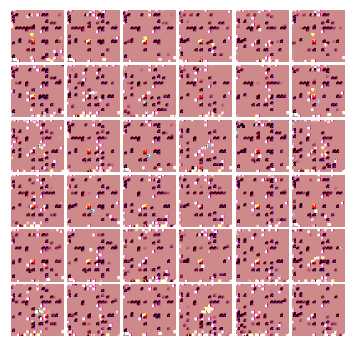


Iter:19200, D:2.649e-08, G:27.63
epoch:3841---------------------------------
Iter:19205, D:4.636e-08, G:27.63
epoch:3842---------------------------------
Iter:19210, D:-0.0, G:27.63
epoch:3843---------------------------------
Iter:19215, D:2.947e-07, G:27.63
epoch:3844---------------------------------
Iter:19220, D:3.302e-06, G:27.63
epoch:3845---------------------------------
Iter:19225, D:9.934e-09, G:27.63
epoch:3846---------------------------------
Iter:19230, D:3.212e-07, G:27.63
epoch:3847---------------------------------
Iter:19235, D:4.967e-08, G:27.63
epoch:3848---------------------------------
Iter:19240, D:8.179e-07, G:27.63
epoch:3849---------------------------------
Iter:19245, D:3.354e-06, G:27.63
epoch:3850---------------------------------
Iter:19250, D:3.039e-05, G:27.63
epoch:3851---------------------------------
Iter:19255, D:1.017e-06, G:27.63
epoch:3852---------------------------------
Iter:19260, D:3.344e-07, G:27.63
epoch:3853---------------------------------
Ite

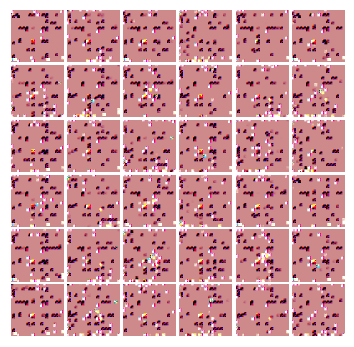


Iter:19400, D:2.535e-05, G:27.63
epoch:3881---------------------------------
Iter:19405, D:2.478e-05, G:27.63
epoch:3882---------------------------------
Iter:19410, D:1.523e-07, G:27.63
epoch:3883---------------------------------
Iter:19415, D:2.109e-06, G:27.63
epoch:3884---------------------------------
Iter:19420, D:2.572e-05, G:27.63
epoch:3885---------------------------------
Iter:19425, D:8.411e-07, G:27.63
epoch:3886---------------------------------
Iter:19430, D:8.378e-07, G:27.63
epoch:3887---------------------------------
Iter:19435, D:6.755e-07, G:27.63
epoch:3888---------------------------------
Iter:19440, D:3.046e-07, G:27.63
epoch:3889---------------------------------
Iter:19445, D:2.222e-06, G:27.63
epoch:3890---------------------------------
Iter:19450, D:6.358e-07, G:27.63
epoch:3891---------------------------------
Iter:19455, D:1.05e-06, G:27.63
epoch:3892---------------------------------
Iter:19460, D:9.868e-07, G:27.63
epoch:3893---------------------------------

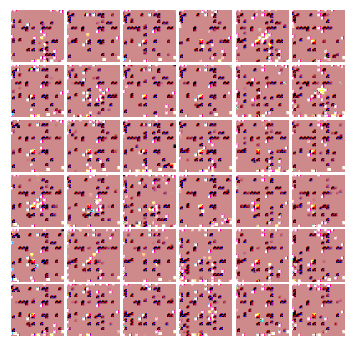


Iter:19600, D:7.285e-07, G:27.63
epoch:3921---------------------------------
Iter:19605, D:8.312e-07, G:27.63
epoch:3922---------------------------------
Iter:19610, D:1.692e-06, G:27.63
epoch:3923---------------------------------
Iter:19615, D:2.087e-05, G:27.63
epoch:3924---------------------------------
Iter:19620, D:2.748e-07, G:27.63
epoch:3925---------------------------------
Iter:19625, D:1.593e-06, G:27.63
epoch:3926---------------------------------
Iter:19630, D:9.934e-09, G:27.63
epoch:3927---------------------------------
Iter:19635, D:1.305e-06, G:27.63
epoch:3928---------------------------------
Iter:19640, D:2.026e-05, G:27.63
epoch:3929---------------------------------
Iter:19645, D:-0.0, G:27.63
epoch:3930---------------------------------
Iter:19650, D:1.686e-06, G:27.63
epoch:3931---------------------------------
Iter:19655, D:1.94e-05, G:27.63
epoch:3932---------------------------------
Iter:19660, D:7.55e-07, G:27.63
epoch:3933---------------------------------
Iter:

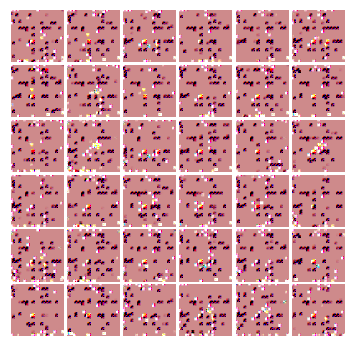


Iter:19800, D:1.689e-07, G:27.63
epoch:3961---------------------------------
Iter:19805, D:7.749e-07, G:27.63
epoch:3962---------------------------------
Iter:19810, D:9.769e-07, G:27.63
epoch:3963---------------------------------
Iter:19815, D:1.056e-06, G:27.63
epoch:3964---------------------------------
Iter:19820, D:2.98e-08, G:27.63
epoch:3965---------------------------------
Iter:19825, D:2.219e-07, G:27.63
epoch:3966---------------------------------
Iter:19830, D:6.656e-07, G:27.63
epoch:3967---------------------------------
Iter:19835, D:9.603e-08, G:27.63
epoch:3968---------------------------------
Iter:19840, D:7.252e-07, G:27.63
epoch:3969---------------------------------
Iter:19845, D:5.133e-07, G:27.63
epoch:3970---------------------------------
Iter:19850, D:2.517e-07, G:27.63
epoch:3971---------------------------------
Iter:19855, D:3.974e-08, G:27.63
epoch:3972---------------------------------
Iter:19860, D:8.278e-08, G:27.63
epoch:3973---------------------------------

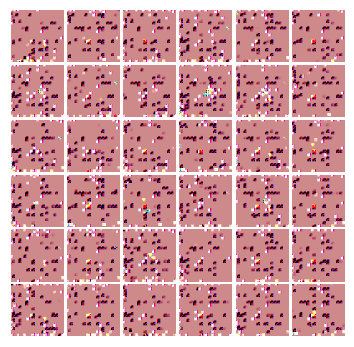


Iter:20000, D:4.636e-08, G:27.63
epoch:4001---------------------------------
Iter:20005, D:3.676e-07, G:27.63
epoch:4002---------------------------------
Iter:20010, D:1.232e-06, G:27.63
epoch:4003---------------------------------
Iter:20015, D:4.835e-07, G:27.63
epoch:4004---------------------------------
Iter:20020, D:6.954e-08, G:27.63
epoch:4005---------------------------------
Iter:20025, D:5.596e-07, G:27.63
epoch:4006---------------------------------
Iter:20030, D:4.967e-07, G:27.63
epoch:4007---------------------------------
Iter:20035, D:8.742e-07, G:27.63
epoch:4008---------------------------------
Iter:20040, D:5.53e-07, G:27.63
epoch:4009---------------------------------
Iter:20045, D:5.166e-07, G:27.63
epoch:4010---------------------------------
Iter:20050, D:5e-07, G:27.63
epoch:4011---------------------------------
Iter:20055, D:9.535e-06, G:27.63
epoch:4012---------------------------------
Iter:20060, D:8.411e-07, G:27.63
epoch:4013---------------------------------
Ite

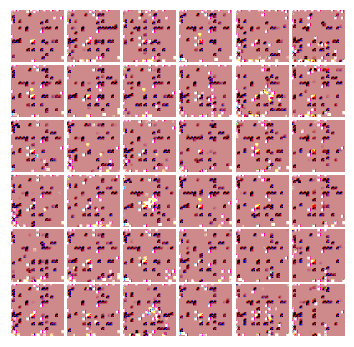


Iter:20200, D:6.701e-06, G:27.63
epoch:4041---------------------------------
Iter:20205, D:-0.0, G:27.63
epoch:4042---------------------------------
Iter:20210, D:6.623e-09, G:27.63
epoch:4043---------------------------------
Iter:20215, D:4.305e-07, G:27.63
epoch:4044---------------------------------
Iter:20220, D:-0.0, G:27.63
epoch:4045---------------------------------
Iter:20225, D:3.311e-08, G:27.63
epoch:4046---------------------------------
Iter:20230, D:2.914e-07, G:27.63
epoch:4047---------------------------------
Iter:20235, D:1.987e-07, G:27.63
epoch:4048---------------------------------
Iter:20240, D:3.974e-08, G:27.63
epoch:4049---------------------------------
Iter:20245, D:2.748e-07, G:27.63
epoch:4050---------------------------------
Iter:20250, D:6.623e-09, G:27.63
epoch:4051---------------------------------
Iter:20255, D:6.34e-06, G:27.63
epoch:4052---------------------------------
Iter:20260, D:4.868e-07, G:27.63
epoch:4053---------------------------------
Iter:2026

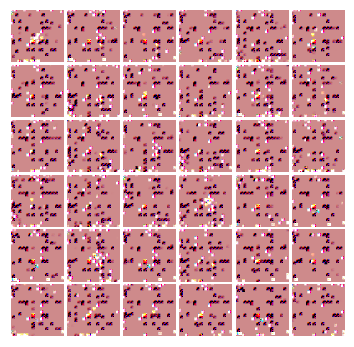


Iter:20400, D:3.576e-07, G:27.63
epoch:4081---------------------------------
Iter:20405, D:2.086e-07, G:27.63
epoch:4082---------------------------------
Iter:20410, D:1.033e-06, G:27.63
epoch:4083---------------------------------
Iter:20415, D:2.748e-07, G:27.63
epoch:4084---------------------------------
Iter:20420, D:5.353e-06, G:27.63
epoch:4085---------------------------------
Iter:20425, D:7.318e-07, G:27.63
epoch:4086---------------------------------
Iter:20430, D:5.976e-06, G:27.63
epoch:4087---------------------------------
Iter:20435, D:4.503e-07, G:27.63
epoch:4088---------------------------------
Iter:20440, D:3.576e-07, G:27.63
epoch:4089---------------------------------
Iter:20445, D:5.241e-06, G:27.63
epoch:4090---------------------------------
Iter:20450, D:5.828e-07, G:27.63
epoch:4091---------------------------------
Iter:20455, D:-0.0, G:27.63
epoch:4092---------------------------------
Iter:20460, D:6.424e-07, G:27.63
epoch:4093---------------------------------
Ite

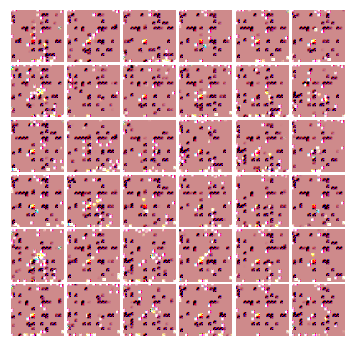


Iter:20600, D:2.881e-07, G:27.63
epoch:4121---------------------------------
Iter:20605, D:5.596e-07, G:27.63
epoch:4122---------------------------------
Iter:20610, D:3.841e-07, G:27.63
epoch:4123---------------------------------
Iter:20615, D:2.384e-07, G:27.63
epoch:4124---------------------------------
Iter:20620, D:1.325e-08, G:27.63
epoch:4125---------------------------------
Iter:20625, D:3.841e-07, G:27.63
epoch:4126---------------------------------
Iter:20630, D:4.583e-06, G:27.63
epoch:4127---------------------------------
Iter:20635, D:1.656e-08, G:27.63
epoch:4128---------------------------------
Iter:20640, D:2.748e-07, G:27.63
epoch:4129---------------------------------
Iter:20645, D:7.583e-07, G:27.63
epoch:4130---------------------------------
Iter:20650, D:-0.0, G:27.63
epoch:4131---------------------------------
Iter:20655, D:2.98e-07, G:27.63
epoch:4132---------------------------------
Iter:20660, D:1.523e-07, G:27.63
epoch:4133---------------------------------
Iter

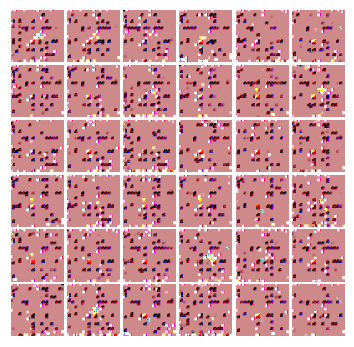


Iter:20800, D:3.838e-06, G:27.63
epoch:4161---------------------------------
Iter:20805, D:4.967e-08, G:27.63
epoch:4162---------------------------------
Iter:20810, D:2.252e-07, G:27.63
epoch:4163---------------------------------
Iter:20815, D:5.166e-07, G:27.63
epoch:4164---------------------------------
Iter:20820, D:2.848e-07, G:27.63
epoch:4165---------------------------------
Iter:20825, D:2.318e-08, G:27.63
epoch:4166---------------------------------
Iter:20830, D:2.119e-07, G:27.63
epoch:4167---------------------------------
Iter:20835, D:2.152e-07, G:27.63
epoch:4168---------------------------------
Iter:20840, D:9.603e-08, G:27.63
epoch:4169---------------------------------
Iter:20845, D:6.623e-09, G:27.63
epoch:4170---------------------------------
Iter:20850, D:9.934e-09, G:27.63
epoch:4171---------------------------------
Iter:20855, D:3.855e-06, G:27.63
epoch:4172---------------------------------
Iter:20860, D:2.98e-08, G:27.63
epoch:4173---------------------------------

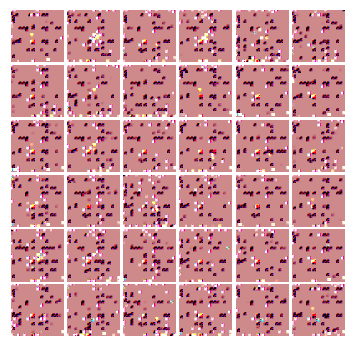


Iter:21000, D:3.514e-06, G:27.63
epoch:4201---------------------------------
Iter:21005, D:7.186e-07, G:27.63
epoch:4202---------------------------------
Iter:21010, D:6.623e-09, G:27.63
epoch:4203---------------------------------
Iter:21015, D:3.163e-06, G:27.63
epoch:4204---------------------------------
Iter:21020, D:3.318e-06, G:27.63
epoch:4205---------------------------------
Iter:21025, D:8.941e-08, G:27.63
epoch:4206---------------------------------
Iter:21030, D:1.987e-08, G:27.63
epoch:4207---------------------------------
Iter:21035, D:3e-06, G:27.63
epoch:4208---------------------------------
Iter:21040, D:7.616e-08, G:27.63
epoch:4209---------------------------------
Iter:21045, D:1.556e-07, G:27.63
epoch:4210---------------------------------
Iter:21050, D:2.318e-08, G:27.63
epoch:4211---------------------------------
Iter:21055, D:8.278e-08, G:27.63
epoch:4212---------------------------------
Iter:21060, D:4.007e-07, G:27.63
epoch:4213---------------------------------
It

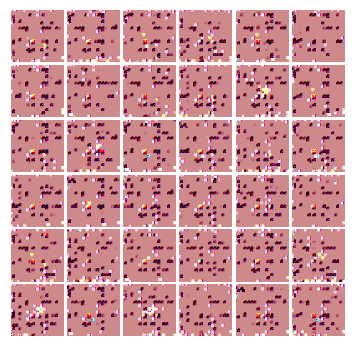


Iter:21200, D:5.033e-07, G:27.63
epoch:4241---------------------------------
Iter:21205, D:2.623e-06, G:27.63
epoch:4242---------------------------------
Iter:21210, D:2.881e-07, G:27.63
epoch:4243---------------------------------
Iter:21215, D:1.656e-08, G:27.63
epoch:4244---------------------------------
Iter:21220, D:2.583e-06, G:27.63
epoch:4245---------------------------------
Iter:21225, D:9.934e-08, G:27.63
epoch:4246---------------------------------
Iter:21230, D:1.987e-08, G:27.63
epoch:4247---------------------------------
Iter:21235, D:1.921e-07, G:27.63
epoch:4248---------------------------------
Iter:21240, D:2.02e-07, G:27.63
epoch:4249---------------------------------
Iter:21245, D:1.656e-08, G:27.63
epoch:4250---------------------------------
Iter:21250, D:7.616e-08, G:27.63
epoch:4251---------------------------------
Iter:21255, D:2.947e-07, G:27.63
epoch:4252---------------------------------
Iter:21260, D:8.61e-08, G:27.63
epoch:4253---------------------------------


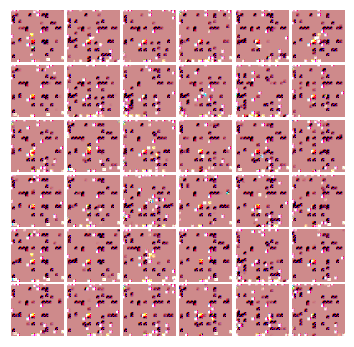


Iter:21400, D:2.123e-06, G:27.63
epoch:4281---------------------------------
Iter:21405, D:1.325e-07, G:27.63
epoch:4282---------------------------------
Iter:21410, D:1.656e-08, G:27.63
epoch:4283---------------------------------
Iter:21415, D:1.457e-07, G:27.63
epoch:4284---------------------------------
Iter:21420, D:2.275e-06, G:27.63
epoch:4285---------------------------------
Iter:21425, D:6.623e-09, G:27.63
epoch:4286---------------------------------
Iter:21430, D:2.5e-06, G:27.63
epoch:4287---------------------------------
Iter:21435, D:3.974e-08, G:27.63
epoch:4288---------------------------------
Iter:21440, D:1.291e-07, G:27.63
epoch:4289---------------------------------
Iter:21445, D:1.821e-07, G:27.63
epoch:4290---------------------------------
Iter:21450, D:2.318e-08, G:27.63
epoch:4291---------------------------------
Iter:21455, D:6.954e-08, G:27.63
epoch:4292---------------------------------
Iter:21460, D:3.609e-07, G:27.63
epoch:4293---------------------------------


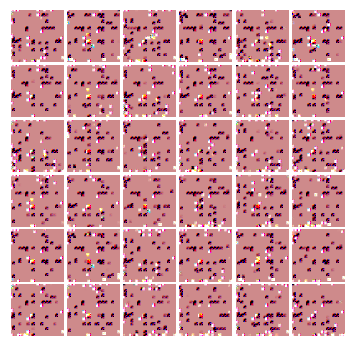


Iter:21600, D:1.854e-06, G:27.63
epoch:4321---------------------------------
Iter:21605, D:3.311e-09, G:27.63
epoch:4322---------------------------------
Iter:21610, D:1.997e-06, G:27.63
epoch:4323---------------------------------
Iter:21615, D:1.831e-06, G:27.63
epoch:4324---------------------------------
Iter:21620, D:4.47e-07, G:27.63
epoch:4325---------------------------------
Iter:21625, D:1.987e-08, G:27.63
epoch:4326---------------------------------
Iter:21630, D:1.126e-07, G:27.63
epoch:4327---------------------------------
Iter:21635, D:5.96e-08, G:27.63
epoch:4328---------------------------------
Iter:21640, D:6.292e-08, G:27.63
epoch:4329---------------------------------
Iter:21645, D:3.609e-07, G:27.63
epoch:4330---------------------------------
Iter:21650, D:1.722e-07, G:27.63
epoch:4331---------------------------------
Iter:21655, D:2.318e-08, G:27.63
epoch:4332---------------------------------
Iter:21660, D:2.318e-08, G:27.63
epoch:4333---------------------------------


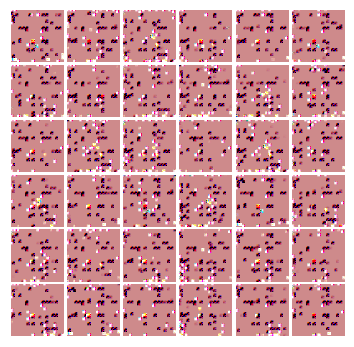


Iter:21800, D:1.745e-06, G:27.63
epoch:4361---------------------------------
Iter:21805, D:1.669e-06, G:27.63
epoch:4362---------------------------------
Iter:21810, D:2.45e-07, G:27.63
epoch:4363---------------------------------
Iter:21815, D:4.967e-08, G:27.63
epoch:4364---------------------------------
Iter:21820, D:2.45e-07, G:27.63
epoch:4365---------------------------------
Iter:21825, D:1.589e-07, G:27.63
epoch:4366---------------------------------
Iter:21830, D:1.722e-07, G:27.63
epoch:4367---------------------------------
Iter:21835, D:2.318e-07, G:27.63
epoch:4368---------------------------------
Iter:21840, D:2.318e-07, G:27.63
epoch:4369---------------------------------
Iter:21845, D:1.391e-07, G:27.63
epoch:4370---------------------------------
Iter:21850, D:1.801e-06, G:27.63
epoch:4371---------------------------------
Iter:21855, D:1.358e-07, G:27.63
epoch:4372---------------------------------
Iter:21860, D:1.679e-06, G:27.63
epoch:4373---------------------------------


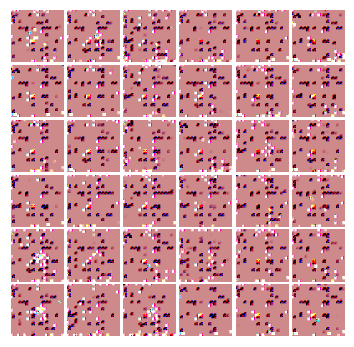


Iter:22000, D:4.967e-08, G:27.63
epoch:4401---------------------------------
Iter:22005, D:3.643e-08, G:27.63
epoch:4402---------------------------------
Iter:22010, D:1.291e-07, G:27.63
epoch:4403---------------------------------
Iter:22015, D:1.652e-06, G:27.63
epoch:4404---------------------------------
Iter:22020, D:2.318e-08, G:27.63
epoch:4405---------------------------------
Iter:22025, D:2.881e-07, G:27.63
epoch:4406---------------------------------
Iter:22030, D:2.02e-07, G:27.63
epoch:4407---------------------------------
Iter:22035, D:1.421e-06, G:27.63
epoch:4408---------------------------------
Iter:22040, D:3.311e-07, G:27.63
epoch:4409---------------------------------
Iter:22045, D:5.96e-08, G:27.63
epoch:4410---------------------------------
Iter:22050, D:2.484e-07, G:27.63
epoch:4411---------------------------------
Iter:22055, D:1.325e-07, G:27.63
epoch:4412---------------------------------
Iter:22060, D:2.649e-08, G:27.63
epoch:4413---------------------------------


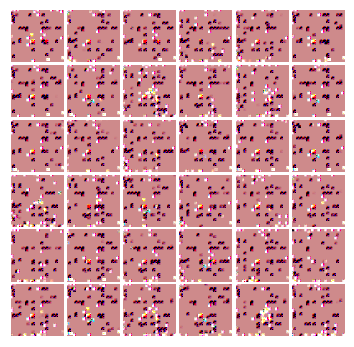


Iter:22200, D:2.715e-07, G:27.63
epoch:4441---------------------------------
Iter:22205, D:1.093e-07, G:27.63
epoch:4442---------------------------------
Iter:22210, D:1.381e-06, G:27.63
epoch:4443---------------------------------
Iter:22215, D:1.328e-06, G:27.63
epoch:4444---------------------------------
Iter:22220, D:1.159e-07, G:27.63
epoch:4445---------------------------------
Iter:22225, D:3.146e-07, G:27.63
epoch:4446---------------------------------
Iter:22230, D:2.881e-07, G:27.63
epoch:4447---------------------------------
Iter:22235, D:7.616e-08, G:27.63
epoch:4448---------------------------------
Iter:22240, D:9.934e-09, G:27.63
epoch:4449---------------------------------
Iter:22245, D:1.987e-08, G:27.63
epoch:4450---------------------------------
Iter:22250, D:3.311e-09, G:27.63
epoch:4451---------------------------------
Iter:22255, D:1.437e-06, G:27.63
epoch:4452---------------------------------
Iter:22260, D:2.086e-07, G:27.63
epoch:4453--------------------------------

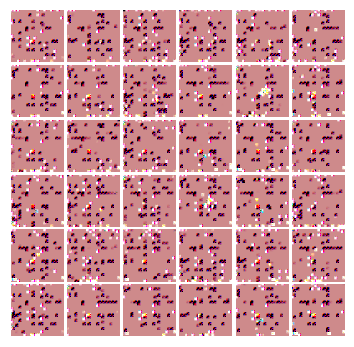


Iter:22400, D:1.182e-06, G:27.63
epoch:4481---------------------------------
Iter:22405, D:1.689e-07, G:27.63
epoch:4482---------------------------------
Iter:22410, D:2.649e-08, G:27.63
epoch:4483---------------------------------
Iter:22415, D:-0.0, G:27.63
epoch:4484---------------------------------
Iter:22420, D:2.98e-08, G:27.63
epoch:4485---------------------------------
Iter:22425, D:9.934e-08, G:27.63
epoch:4486---------------------------------
Iter:22430, D:3.974e-08, G:27.63
epoch:4487---------------------------------
Iter:22435, D:1.656e-07, G:27.63
epoch:4488---------------------------------
Iter:22440, D:9.934e-08, G:27.63
epoch:4489---------------------------------
Iter:22445, D:1.921e-07, G:27.63
epoch:4490---------------------------------
Iter:22450, D:9.603e-08, G:27.63
epoch:4491---------------------------------
Iter:22455, D:2.318e-08, G:27.63
epoch:4492---------------------------------
Iter:22460, D:1.623e-07, G:27.63
epoch:4493---------------------------------
Iter

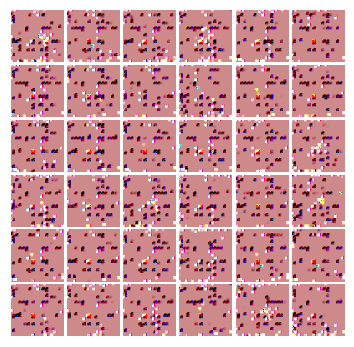


Iter:22600, D:1.225e-07, G:27.63
epoch:4521---------------------------------
Iter:22605, D:-0.0, G:27.63
epoch:4522---------------------------------
Iter:22610, D:5.96e-08, G:27.63
epoch:4523---------------------------------
Iter:22615, D:6.623e-09, G:27.63
epoch:4524---------------------------------
Iter:22620, D:1.291e-07, G:27.63
epoch:4525---------------------------------
Iter:22625, D:3.311e-09, G:27.63
epoch:4526---------------------------------
Iter:22630, D:3.311e-09, G:27.63
epoch:4527---------------------------------
Iter:22635, D:1.159e-07, G:27.63
epoch:4528---------------------------------
Iter:22640, D:2.55e-07, G:27.63
epoch:4529---------------------------------
Iter:22645, D:-0.0, G:27.63
epoch:4530---------------------------------
Iter:22650, D:9.603e-08, G:27.63
epoch:4531---------------------------------
Iter:22655, D:1.523e-07, G:27.63
epoch:4532---------------------------------
Iter:22660, D:4.636e-08, G:27.63
epoch:4533---------------------------------
Iter:22665

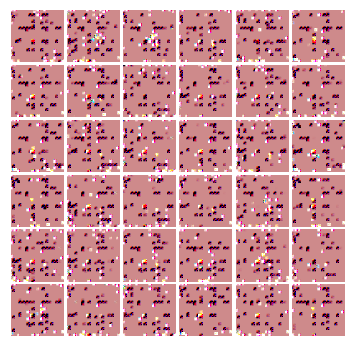


Iter:22800, D:8.278e-08, G:27.63
epoch:4561---------------------------------
Iter:22805, D:1.755e-07, G:27.63
epoch:4562---------------------------------
Iter:22810, D:8.278e-08, G:27.63
epoch:4563---------------------------------
Iter:22815, D:2.98e-08, G:27.63
epoch:4564---------------------------------
Iter:22820, D:1.457e-07, G:27.63
epoch:4565---------------------------------
Iter:22825, D:1.424e-07, G:27.63
epoch:4566---------------------------------
Iter:22830, D:2.318e-08, G:27.63
epoch:4567---------------------------------
Iter:22835, D:7.285e-08, G:27.63
epoch:4568---------------------------------
Iter:22840, D:9.537e-07, G:27.63
epoch:4569---------------------------------
Iter:22845, D:7.947e-08, G:27.63
epoch:4570---------------------------------
Iter:22850, D:2.053e-07, G:27.63
epoch:4571---------------------------------
Iter:22855, D:1.556e-07, G:27.63
epoch:4572---------------------------------
Iter:22860, D:1.159e-07, G:27.63
epoch:4573---------------------------------

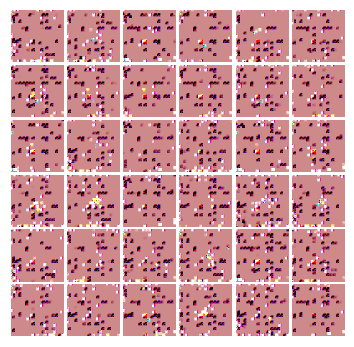


Iter:23000, D:1.854e-07, G:27.63
epoch:4601---------------------------------
Iter:23005, D:1.987e-08, G:27.63
epoch:4602---------------------------------
Iter:23010, D:6.623e-09, G:27.63
epoch:4603---------------------------------
Iter:23015, D:8.61e-07, G:27.63
epoch:4604---------------------------------
Iter:23020, D:3.311e-09, G:27.63
epoch:4605---------------------------------
Iter:23025, D:-0.0, G:27.63
epoch:4606---------------------------------
Iter:23030, D:8.61e-07, G:27.63
epoch:4607---------------------------------
Iter:23035, D:2.318e-08, G:27.63
epoch:4608---------------------------------
Iter:23040, D:1.854e-07, G:27.63
epoch:4609---------------------------------
Iter:23045, D:1.424e-07, G:27.63
epoch:4610---------------------------------
Iter:23050, D:6.623e-09, G:27.63
epoch:4611---------------------------------
Iter:23055, D:8.279e-07, G:27.63
epoch:4612---------------------------------
Iter:23060, D:8.61e-08, G:27.63
epoch:4613---------------------------------
Iter:2

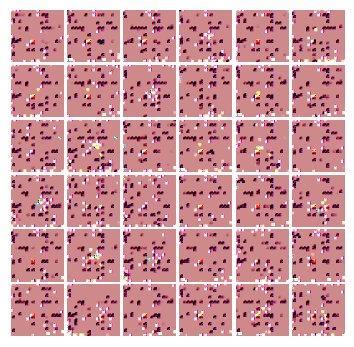


Iter:23200, D:9.934e-08, G:27.63
epoch:4641---------------------------------
Iter:23205, D:3.974e-08, G:27.63
epoch:4642---------------------------------
Iter:23210, D:3.311e-09, G:27.63
epoch:4643---------------------------------
Iter:23215, D:3.974e-08, G:27.63
epoch:4644---------------------------------
Iter:23220, D:3.311e-09, G:27.63
epoch:4645---------------------------------
Iter:23225, D:6.292e-08, G:27.63
epoch:4646---------------------------------
Iter:23230, D:-0.0, G:27.63
epoch:4647---------------------------------
Iter:23235, D:1.192e-07, G:27.63
epoch:4648---------------------------------
Iter:23240, D:5.629e-08, G:27.63
epoch:4649---------------------------------
Iter:23245, D:8.047e-07, G:27.63
epoch:4650---------------------------------
Iter:23250, D:3.974e-08, G:27.63
epoch:4651---------------------------------
Iter:23255, D:7.55e-07, G:27.63
epoch:4652---------------------------------
Iter:23260, D:3.311e-09, G:27.63
epoch:4653---------------------------------
Iter

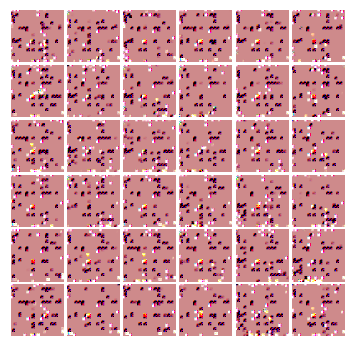


Iter:23400, D:7.616e-08, G:27.63
epoch:4681---------------------------------
Iter:23405, D:7.285e-08, G:27.63
epoch:4682---------------------------------
Iter:23410, D:3.643e-08, G:27.63
epoch:4683---------------------------------
Iter:23415, D:7.285e-08, G:27.63
epoch:4684---------------------------------
Iter:23420, D:-0.0, G:27.63
epoch:4685---------------------------------
Iter:23425, D:6.855e-07, G:27.63
epoch:4686---------------------------------
Iter:23430, D:9.934e-09, G:27.63
epoch:4687---------------------------------
Iter:23435, D:2.649e-08, G:27.63
epoch:4688---------------------------------
Iter:23440, D:1.225e-07, G:27.63
epoch:4689---------------------------------
Iter:23445, D:2.98e-08, G:27.63
epoch:4690---------------------------------
Iter:23450, D:3.311e-08, G:27.63
epoch:4691---------------------------------
Iter:23455, D:5.298e-08, G:27.63
epoch:4692---------------------------------
Iter:23460, D:6.788e-07, G:27.63
epoch:4693---------------------------------
Iter

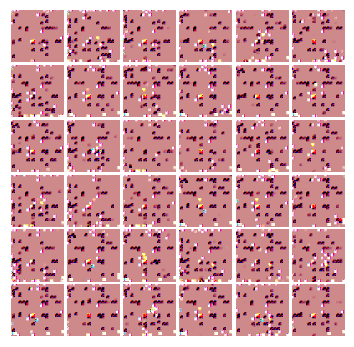


Iter:23600, D:1.027e-07, G:27.63
epoch:4721---------------------------------
Iter:23605, D:1.921e-07, G:27.63
epoch:4722---------------------------------
Iter:23610, D:2.98e-08, G:27.63
epoch:4723---------------------------------
Iter:23615, D:4.636e-08, G:27.63
epoch:4724---------------------------------
Iter:23620, D:1.325e-08, G:27.63
epoch:4725---------------------------------
Iter:23625, D:6.225e-07, G:27.63
epoch:4726---------------------------------
Iter:23630, D:4.967e-08, G:27.63
epoch:4727---------------------------------
Iter:23635, D:2.318e-08, G:27.63
epoch:4728---------------------------------
Iter:23640, D:6.623e-09, G:27.63
epoch:4729---------------------------------
Iter:23645, D:1.325e-08, G:27.63
epoch:4730---------------------------------
Iter:23650, D:6.623e-09, G:27.63
epoch:4731---------------------------------
Iter:23655, D:4.305e-08, G:27.63
epoch:4732---------------------------------
Iter:23660, D:7.285e-08, G:27.63
epoch:4733---------------------------------

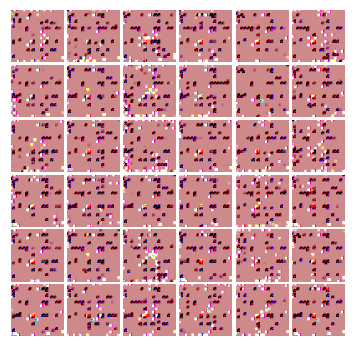


Iter:23800, D:9.934e-09, G:27.63
epoch:4761---------------------------------
Iter:23805, D:2.98e-08, G:27.63
epoch:4762---------------------------------
Iter:23810, D:-0.0, G:27.63
epoch:4763---------------------------------
Iter:23815, D:4.305e-08, G:27.63
epoch:4764---------------------------------
Iter:23820, D:6.292e-08, G:27.63
epoch:4765---------------------------------
Iter:23825, D:9.934e-09, G:27.63
epoch:4766---------------------------------
Iter:23830, D:1.325e-08, G:27.63
epoch:4767---------------------------------
Iter:23835, D:3.643e-08, G:27.63
epoch:4768---------------------------------
Iter:23840, D:-0.0, G:27.63
epoch:4769---------------------------------
Iter:23845, D:6.292e-08, G:27.63
epoch:4770---------------------------------
Iter:23850, D:3.311e-09, G:27.63
epoch:4771---------------------------------
Iter:23855, D:1.391e-07, G:27.63
epoch:4772---------------------------------
Iter:23860, D:1.126e-07, G:27.63
epoch:4773---------------------------------
Iter:2386

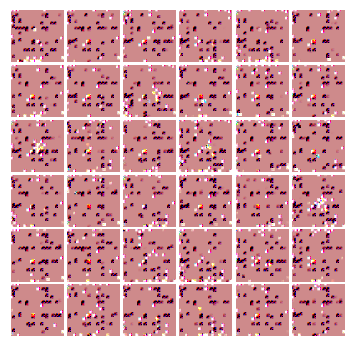


Iter:24000, D:5.53e-07, G:27.63
epoch:4801---------------------------------
Iter:24005, D:3.311e-09, G:27.63
epoch:4802---------------------------------
Iter:24010, D:9.934e-09, G:27.63
epoch:4803---------------------------------
Iter:24015, D:8.61e-08, G:27.63
epoch:4804---------------------------------
Iter:24020, D:2.649e-08, G:27.63
epoch:4805---------------------------------
Iter:24025, D:6.126e-07, G:27.63
epoch:4806---------------------------------
Iter:24030, D:3.311e-09, G:27.63
epoch:4807---------------------------------
Iter:24035, D:2.649e-08, G:27.63
epoch:4808---------------------------------
Iter:24040, D:6.623e-09, G:27.63
epoch:4809---------------------------------
Iter:24045, D:1.06e-07, G:27.63
epoch:4810---------------------------------
Iter:24050, D:5.265e-07, G:27.63
epoch:4811---------------------------------
Iter:24055, D:2.98e-08, G:27.63
epoch:4812---------------------------------
Iter:24060, D:1.325e-08, G:27.63
epoch:4813---------------------------------
It

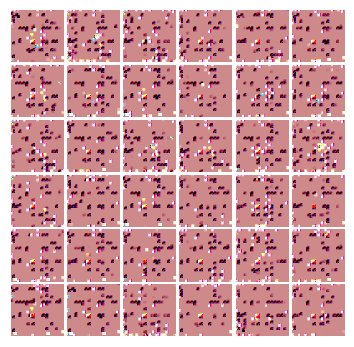


Iter:24200, D:4.636e-08, G:27.63
epoch:4841---------------------------------
Iter:24205, D:4.47e-07, G:27.63
epoch:4842---------------------------------
Iter:24210, D:-0.0, G:27.63
epoch:4843---------------------------------
Iter:24215, D:1.126e-07, G:27.63
epoch:4844---------------------------------
Iter:24220, D:7.616e-08, G:27.63
epoch:4845---------------------------------
Iter:24225, D:3.311e-08, G:27.63
epoch:4846---------------------------------
Iter:24230, D:3.311e-09, G:27.63
epoch:4847---------------------------------
Iter:24235, D:1.325e-08, G:27.63
epoch:4848---------------------------------
Iter:24240, D:1.656e-08, G:27.63
epoch:4849---------------------------------
Iter:24245, D:2.98e-08, G:27.63
epoch:4850---------------------------------
Iter:24250, D:4.47e-07, G:27.63
epoch:4851---------------------------------
Iter:24255, D:-0.0, G:27.63
epoch:4852---------------------------------
Iter:24260, D:9.934e-09, G:27.63
epoch:4853---------------------------------
Iter:24265,

KeyboardInterrupt: 

In [12]:
tf.reset_default_graph()
img_size = cifar_10.shape[1]
x = tf.placeholder(tf.float32,[batch_size,img_size*img_size*3])#----------------------------------------change para
img_real = x
z = sample_noise(batch_size,noise_dim) 
G_sample = generator(z)#output [batch,96*96*3]
out_img = tf.reshape(deprocess(G_sample[:save_size]),[-1,img_size,img_size,3])#------------------------change para  #resize shape. 9696

                                                        #output = [batch,96,96,3] 

with tf.variable_scope("") as scope:
    logits_real = discriminator(preprocess(x))
    scope.reuse_variables()
    logits_fake = discriminator(G_sample)
    
D_vars = tf.get_collection(tf.GraphKeys.TRAINABLE_VARIABLES,'discriminator')
G_vars = tf.get_collection(tf.GraphKeys.TRAINABLE_VARIABLES,'generator')
d_solver,g_solver = get_solvers()

d_loss,g_loss = dcgan_loss(logits_real,logits_fake,batch_size,x,G_sample) #change loss oneonoeneone ----------------
d_train_step = d_solver.minimize(d_loss,var_list=D_vars)
g_train_step = g_solver.minimize(g_loss,var_list=G_vars)
d_extra_step = tf.get_collection(tf.GraphKeys.UPDATE_OPS,'discriminator')
g_extra_step = tf.get_collection(tf.GraphKeys.UPDATE_OPS,'generator')
tf.summary.image("image",out_img,max_outputs=save_size)
merged = tf.summary.merge_all()

with session() as sess:
    try:
        with tf.device("/gpu:0") as dev:
            #merged
            
            ##initialize
            sess.run(tf.global_variables_initializer())
            
            
            train_writer = tf.summary.FileWriter(log_dir,sess.graph)
            
            train(sess,g_train_step,g_loss,d_train_step,d_loss,g_extra_step,d_extra_step,
                  show_every=200,print_every=5,batch_size=batch_size,num_epoch=5000)    
    except tf.errors.InvalidArgumentError:
        print("no gpu found, please use Google Cloud if you want GPU acceleration") 
